# Plot ensemble mean performance of models for comparison.


In [1]:
import numpy as np
import matplotlib.pyplot as plt
import os
from collections import defaultdict
from ensembleUtils import Evaluator
import seaborn as sns
import pandas as pd
from scipy.stats import variation,zscore
import math
from scipy.stats import gaussian_kde
import matplotlib.ticker as ticker
import geopandas as gpd
from matplotlib import colors as cm

## Load simulation results and calculate metrics

In [2]:
rootDir = '../checkpoints/ensemble_ET'
meanOpt = True  # determine whether plot mean performance for ET and snow depth
modelNames = ['DIPINNE_0^T', 'DIPINNE_0^M', 'DIPINNE_0^J', 'DIPINNE_0^T&M', 'DIPINNE_0^T&M&J', 'DIPINNE_0.5^T', 'DIPINNE_0.5^M', 'DIPINNE_0.5^J', 'DIPINNE_0.5^T&M', 'DIPINNE_0.5^T&M&J', 'DIPINNE_1']
stations = ['TNH', 'JUG', 'MAQ', 'MET', 'JIM']
#  initiate a dict to store NSE, r, and PBIAS of streamflow, r and RMSE of ET and snow depth for five models
modelMetric, simulation, valData = dict(), dict(), dict()
for model in modelNames:
    print(f'Calculating metrics for model {model}')
    modelDir = os.path.join(rootDir, model)
    evaluator = Evaluator(ensembleFolder=modelDir,
                          basinFile='../data/sub-basins/watershed.shp',
                          flowFile='../data/streamflow.csv',
                          valDataFile='../data/valData.pkl',
                          LAIFile='../data/LAI.csv')
    modelMetric[model] = evaluator.metric
    valData[model] = evaluator.valData
    simulation[model] = evaluator.sim

Calculating metrics for model DIPINNE_0^T
Calculating metrics for model DIPINNE_0^M
Calculating metrics for model DIPINNE_0^J
Calculating metrics for model DIPINNE_0^T&M
Calculating metrics for model DIPINNE_0^T&M&J
Calculating metrics for model DIPINNE_0.5^T
Calculating metrics for model DIPINNE_0.5^M
Calculating metrics for model DIPINNE_0.5^J
Calculating metrics for model DIPINNE_0.5^T&M
Calculating metrics for model DIPINNE_0.5^T&M&J
Calculating metrics for model DIPINNE_1


## Plot  for streamflow

### Bar plot for ensemble mean metrics

In [7]:
plt.rcParams['font.family'] = 'Arial'
sns.set(style='ticks')

def auto_text(rects, ax, metric):
    for rect in rects:
        height = rect.get_height()
        if height > 0:
            xy=(rect.get_x() + rect.get_width() / 2, height)
        else:
            xy=(rect.get_x() + rect.get_width() / 2, 0)

        text = f'{height: .1f}' if metric in ['PBIAS', 'FLV', 'FHV'] else f'{height: .3f}'
        ax.annotate(text,  # put the detail data
                    xy=xy,  # get the center location.
                    xytext=(0, 1),
                    textcoords='offset points',
                    ha='center', va='bottom', fontsize=10)


# 'x' indicates temporal test station, '+' indicates spatial test stations, nts stands for number of training stations
markers = {'DIPINNE_0^T': {'TNH': 'T', 'MAQ': 'S', 'JIM': 'S', 'HHY': 'S', 'MET': 'S', 'JUG': 'S'},
           'DIPINNE_0.5^T': {'TNH': 'T', 'MAQ': 'S', 'JIM': 'S', 'HHY': 'S', 'MET': 'S', 'JUG': 'S'},
           'DIPINNE_0^M': {'TNH': 'S', 'MAQ': 'T', 'JIM': 'S', 'HHY': 'S', 'MET': 'S', 'JUG': 'S'},
           'DIPINNE_0.5^M': {'TNH': 'S', 'MAQ': 'T', 'JIM': 'S', 'HHY': 'S', 'MET': 'S', 'JUG': 'S'},
           'DIPINNE_0^J': {'TNH': 'S', 'MAQ': 'S', 'JIM': 'T', 'HHY': 'S', 'MET': 'S', 'JUG': 'S'},
           'DIPINNE_0.5^J': {'TNH': 'S', 'MAQ': 'S', 'JIM': 'T', 'HHY': 'S', 'MET': 'S', 'JUG': 'S'},
           'DIPINNE_0^T&M': {'TNH': 'T', 'MAQ': 'T', 'JIM': 'S', 'HHY': 'S', 'MET': 'S', 'JUG': 'S'},
           'DIPINNE_0.5^T&M': {'TNH': 'T', 'MAQ': 'T', 'JIM': 'S', 'HHY': 'S', 'MET': 'S', 'JUG': 'S'},
           'DIPINNE_0^T&M&J': {'TNH': 'T', 'MAQ': 'T', 'JIM': 'T', 'HHY': 'S', 'MET': 'S', 'JUG': 'S'},
           'DIPINNE_0.5^T&M&J': {'TNH': 'T', 'MAQ': 'T', 'JIM': 'T', 'HHY': 'S', 'MET': 'S', 'JUG': 'S'},
           'DIPINNE_1': {'TNH': 'S', 'MAQ': 'S', 'JIM': 'S', 'HHY': 'S', 'MET': 'S', 'JUG': 'S'}}

# color_dict = dict(zip(['DIPINNE_0^T', 'DIPINNE_0^M', 'DIPINNE_0^J', 'DIPINNE_0^T&M', 'DIPINNE_0^T&M&J', 'DIPINNE_0.5^T', 'DIPINNE_0.5^M', 'DIPINNE_0.5^J', 'DIPINNE_0.5^T&M', 'DIPINNE_0.5^T&M&J', 'DIPINNE_1'],
#                       ['#B7B2D0', '#7DA6C6', '#84C3B7', '#EBBA82', '#ECA8A1', '#78739D', '#5B788E', '#6E9C93', '#A27848', '#A25C53', '#C3C9BD']))

color_dict = dict(zip(['DIPINNE_0^T', 'DIPINNE_0^M', 'DIPINNE_0^J', 'DIPINNE_0^T&M', 'DIPINNE_0^T&M&J', 'DIPINNE_0.5^T', 'DIPINNE_0.5^M', 'DIPINNE_0.5^J', 'DIPINNE_0.5^T&M', 'DIPINNE_0.5^T&M&J', 'DIPINNE_1'],
                      ['#84C3B7', '#7DA6C6', '#B7B2D0', '#EBBA82', '#ECA8A1', '#6E9C93', '#5B788E', '#78739D', '#A27848', '#A25C53', '#C3C9BD']))

legend_dict = dict(zip(['DIPINNE_0^T', 'DIPINNE_0^M', 'DIPINNE_0^J', 'DIPINNE_0^T&M', 'DIPINNE_0^T&M&J', 'DIPINNE_0.5^T', 'DIPINNE_0.5^M', 'DIPINNE_0.5^J', 'DIPINNE_0.5^T&M', 'DIPINNE_0.5^T&M&J', 'DIPINNE_1'],
                      ['DIPINNE$_0^T$', 'DIPINNE$_0^M$', 'DIPINNE$_0^J$', 'DIPINNE$_0^{T&M}$', 'DIPINNE$_0^{T&M&J}$', 'DIPINNE$_{0.5}^T$', 'DIPINNE$_{0.5}^M$', 'DIPINNE$_{0.5}^J$', 'DIPINNE$_{0.5}^{T&M}$', 'DIPINNE$_{0.5}^{T&M&J}$', 'DIPINNE$_1$']))

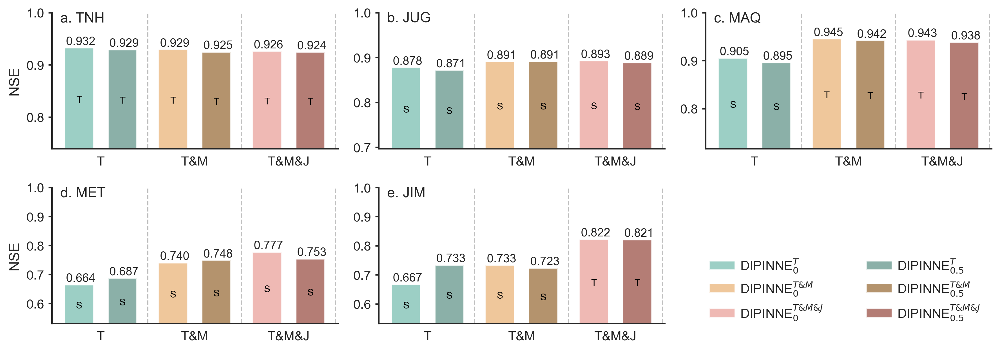

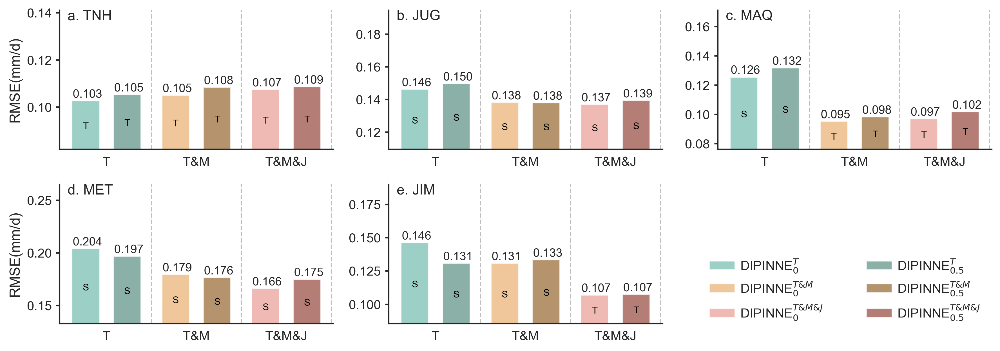

In [8]:
model_plt = ['DIPINNE_0^T', 'DIPINNE_0.5^T', 'DIPINNE_0^T&M', 'DIPINNE_0.5^T&M', 'DIPINNE_0^T&M&J', 'DIPINNE_0.5^T&M&J']

metricUnit = dict(zip(['NSE', 'RMSE'], ['', '(mm/d)']))
for i, metricName in enumerate(metricUnit.keys()):
    fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(12, 4.5), dpi=300)
    for k, station in enumerate(stations):
        yMax, yMin = -9999, 9999
        ax = axes[k//3, k%3]
        boxes = defaultdict()
        space, width = 0.1, 0.2
        for j, model in enumerate(model_plt):
            xTemp = np.array([(space + width) * (0.5 + j) + j // 2 * 0.5 *space])
            yTemp = np.array([modelMetric[model]['Q']['mean'][station][metricName]])
            yMax = yTemp.max() if yTemp.max() > yMax else yMax
            yMin = yTemp.min() if yTemp.min() < yMin else yMin
            rect = ax.bar(xTemp, yTemp, width, color=color_dict[model], label=legend_dict[model], alpha=0.8)
            auto_text(rect, ax, metricName)

        # ax.set_xlabel(station, labelpad=2.5)
        top = min(yMax * 1.6, 1.0) if metricName in ['NSE', 'r', 'KGE'] else yMax * 1.3
        bottom = yMin * 0.8 if yMin > 0 else yMin * 1.1
        ax.set_ylim(top=top, bottom=bottom)
        xticks = [(space + width) * (0.5 + k) + k // 2 * 0.5 * space for k in range(len(model_plt))]
        xticks = [(xticks[0] + xticks[1])/2, (xticks[2] + xticks[3])/2, (xticks[4] + xticks[5])/2]
        ax.set_xticks(xticks)
        # ax.set_xticklabels([f'nts={num}' for num in range(1, 4)])
        ax.set_xticklabels(['T', 'T&M', 'T&M&J'])

        # add scatter plot
        for j, model in enumerate(model_plt):
            xScatter = (space + width) * (0.5 + j) + j // 2 * 0.5 *space
            yScatter = modelMetric[model]['Q']['mean'][station][metricName]
            yScatter = (yScatter - max(bottom, 0)) * 0.5 + max(bottom, 0)
            ax.annotate(markers[model][station], xy=(xScatter, yScatter), xytext=(0, -1.5), ha='center', va='center', fontsize=8, color='black', textcoords='offset points')
            if j in [1, 3, 5]:
                ax.axvline(x=xScatter + 0.75 * space + width / 2, color='grey', linestyle='--', alpha=0.5, linewidth=1)

        ax.tick_params(axis='y', length=3)  # adjust tick length
        ax.tick_params(axis='x', length=3, color='white')  # adjust tick length
        ax.spines['right'].set_visible(False)
        ax.spines['top'].set_visible(False)
        ax.annotate(f'{chr(97+k)}. {station}', xy=(0.03, 0.93), xycoords='axes fraction')
        # ax.grid(axis='y',ls='--',alpha=0.8)

        if k in [0, 3]:
            ax.set_ylabel(metricName + metricUnit[metricName])

    lines, labels = ax.get_legend_handles_labels()
    lines = [lines[0], lines[2], lines[4], lines[1], lines[3], lines[5]]
    labels = [labels[0], labels[2], labels[4], labels[1], labels[3], labels[5]]
    fig.legend(lines, labels, ncol=2, borderaxespad=0.1,
               bbox_to_anchor=(0.7, 0.3, 0.28, 0.02), mode='expand', columnspacing=1, frameon=False, handletextpad=0.4)
    # plt.annotate('T: Temporal test station   S: Spatial test station', xy=(0.8, 0.3), xycoords='figure fraction', ha='center')

    plt.delaxes(ax=axes[1, 2])

    fig.tight_layout(rect=(0, 0.04, 1, 1))

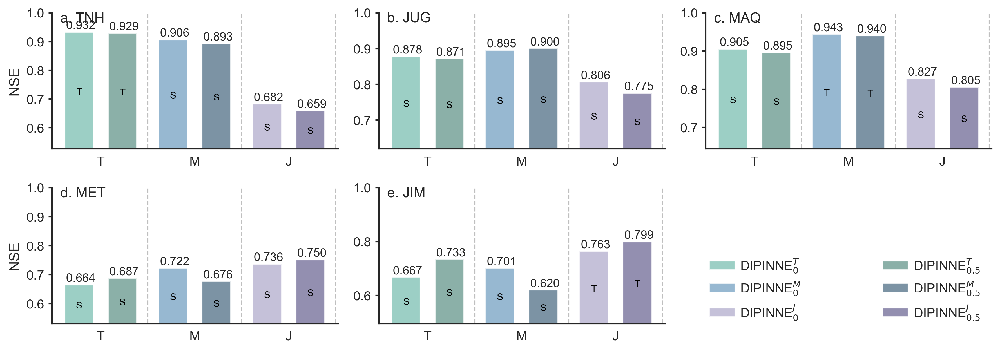

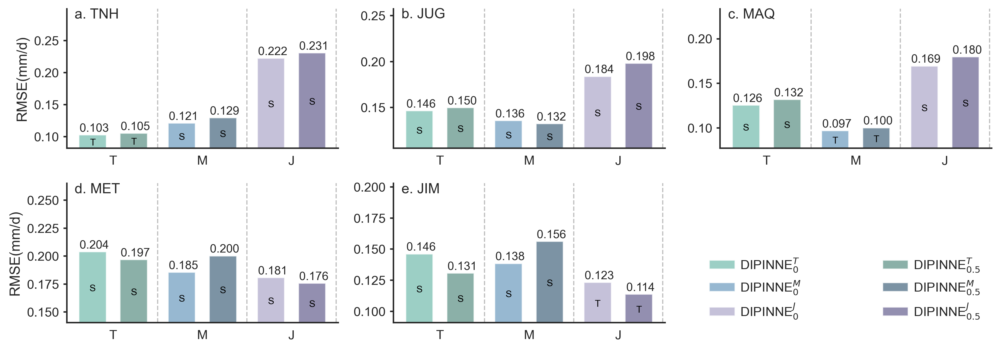

In [9]:
model_plt = ['DIPINNE_0^T', 'DIPINNE_0.5^T', 'DIPINNE_0^M', 'DIPINNE_0.5^M', 'DIPINNE_0^J', 'DIPINNE_0.5^J']

metricUnit = dict(zip(['NSE', 'RMSE'], ['', '(mm/d)']))
for i, metricName in enumerate(metricUnit.keys()):
    fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(12, 4.5), dpi=300)
    for k, station in enumerate(stations):
        yMax, yMin = -9999, 9999
        ax = axes[k//3, k%3]
        boxes = defaultdict()
        space, width = 0.1, 0.2
        for j, model in enumerate(model_plt):
            xTemp = np.array([(space + width) * (0.5 + j) + j // 2 * 0.5 *space])
            yTemp = np.array([modelMetric[model]['Q']['mean'][station][metricName]])
            yMax = yTemp.max() if yTemp.max() > yMax else yMax
            yMin = yTemp.min() if yTemp.min() < yMin else yMin
            rect = ax.bar(xTemp, yTemp, width, color=color_dict[model], label=legend_dict[model], alpha=0.8)
            auto_text(rect, ax, metricName)

        # ax.set_xlabel(station, labelpad=2.5)
        top = min(yMax * 1.6, 1.0) if metricName in ['NSE', 'r', 'KGE'] else yMax * 1.3
        bottom = yMin * 0.8 if yMin > 0 else yMin * 1.1
        ax.set_ylim(top=top, bottom=bottom)
        xticks = [(space + width) * (0.5 + k) + k // 2 * 0.5 * space for k in range(len(model_plt))]
        xticks = [(xticks[0] + xticks[1])/2, (xticks[2] + xticks[3])/2, (xticks[4] + xticks[5])/2]
        ax.set_xticks(xticks)
        ax.set_xticklabels(['T', 'M', 'J'])

        # add scatter plot
        for j, model in enumerate(model_plt):
            xScatter = (space + width) * (0.5 + j) + j // 2 * 0.5 *space
            yScatter = modelMetric[model]['Q']['mean'][station][metricName]
            yScatter = (yScatter - max(bottom, 0)) * 0.5 + max(bottom, 0)
            ax.annotate(markers[model][station], xy=(xScatter, yScatter), xytext=(0, -1.5), ha='center', va='center', fontsize=8, color='black', textcoords='offset points')
            if j in [1, 3, 5]:
                ax.axvline(x=xScatter + 0.75 * space + width / 2, color='grey', linestyle='--', alpha=0.5, linewidth=1)

        ax.tick_params(axis='y', length=3)  # adjust tick length
        ax.tick_params(axis='x', length=3, color='white')  # adjust tick length
        ax.spines['right'].set_visible(False)
        ax.spines['top'].set_visible(False)
        ax.annotate(f'{chr(97+k)}. {station}', xy=(0.03, 0.93), xycoords='axes fraction')
        # ax.grid(axis='y',ls='--',alpha=0.8)

        if k in [0, 3]:
            ax.set_ylabel(metricName + metricUnit[metricName])

    lines, labels = ax.get_legend_handles_labels()
    lines = [lines[0], lines[2], lines[4], lines[1], lines[3], lines[5]]
    labels = [labels[0], labels[2], labels[4], labels[1], labels[3], labels[5]]
    fig.legend(lines, labels, ncol=2, borderaxespad=0.1,
               bbox_to_anchor=(0.7, 0.3, 0.28, 0.02), mode='expand', columnspacing=1, frameon=False, handletextpad=0.4)
    # plt.annotate('T: Temporal test station   S: Spatial test station', xy=(0.8, 0.3), xycoords='figure fraction', ha='center')

    plt.delaxes(ax=axes[1, 2])

    fig.tight_layout(rect=(0, 0.04, 1, 1))

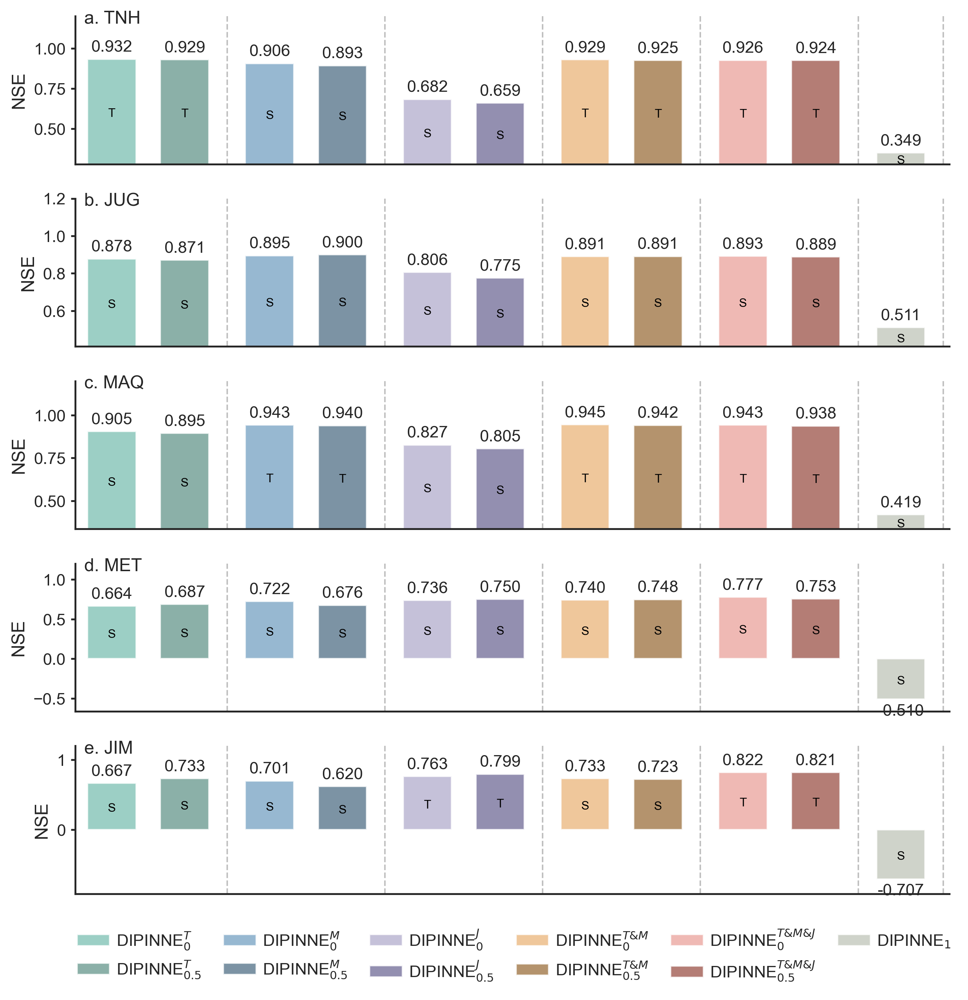

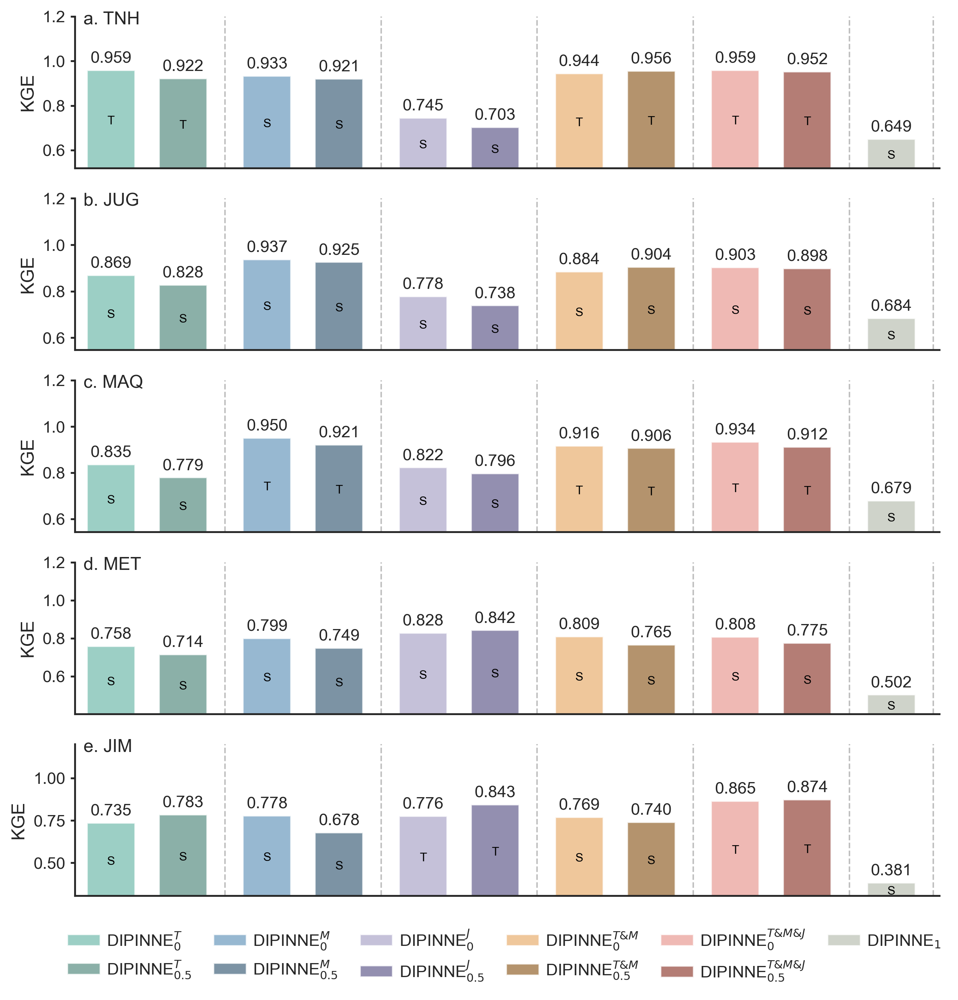

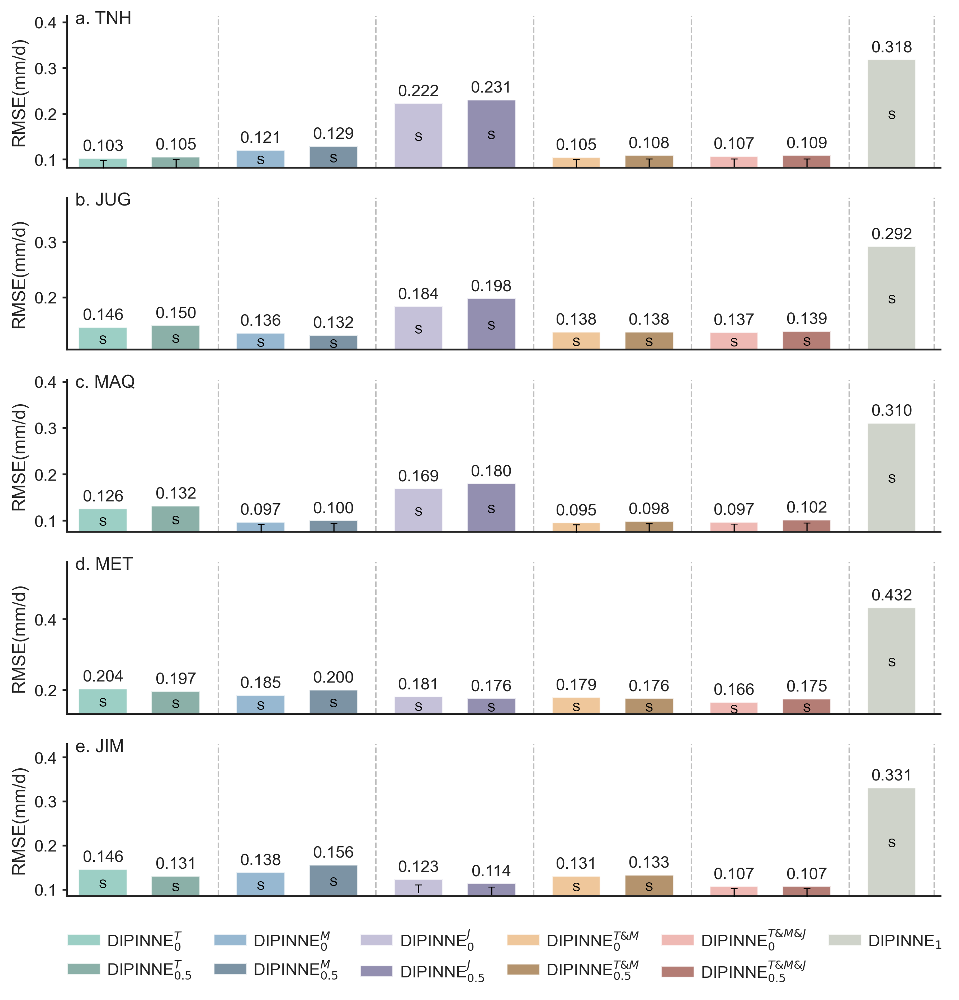

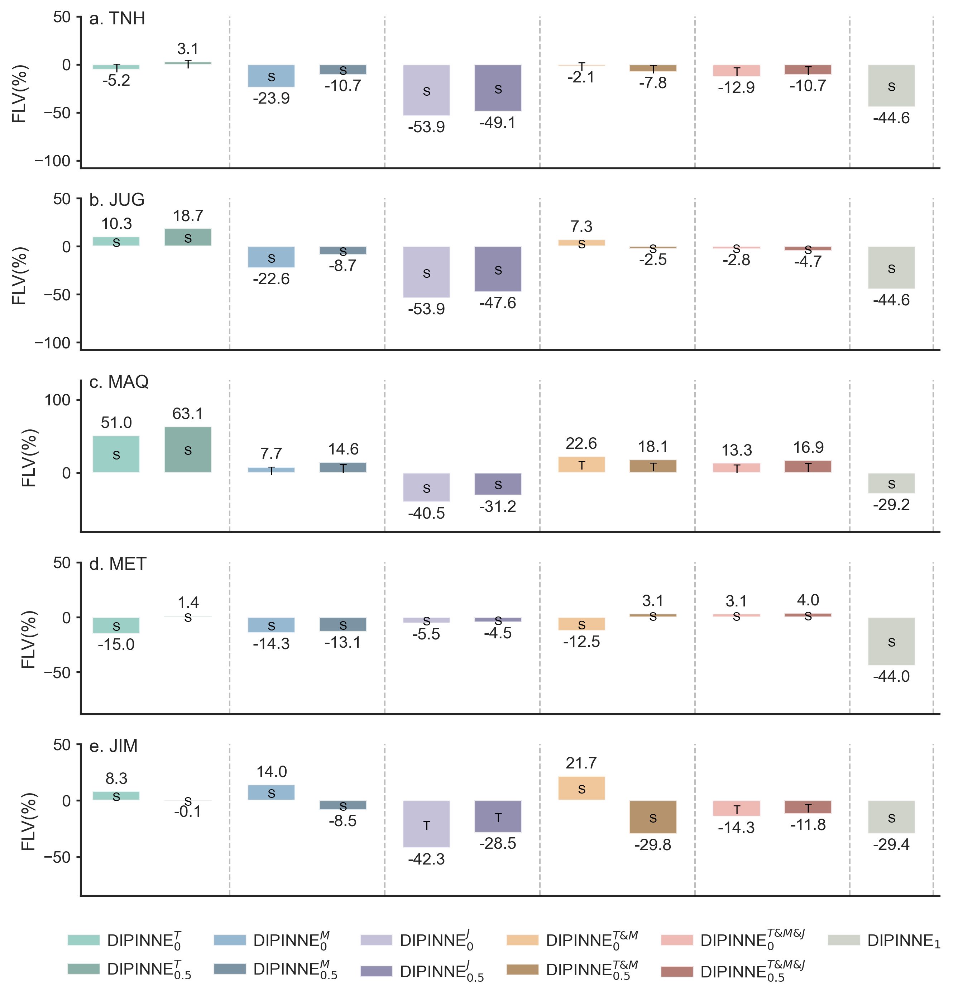

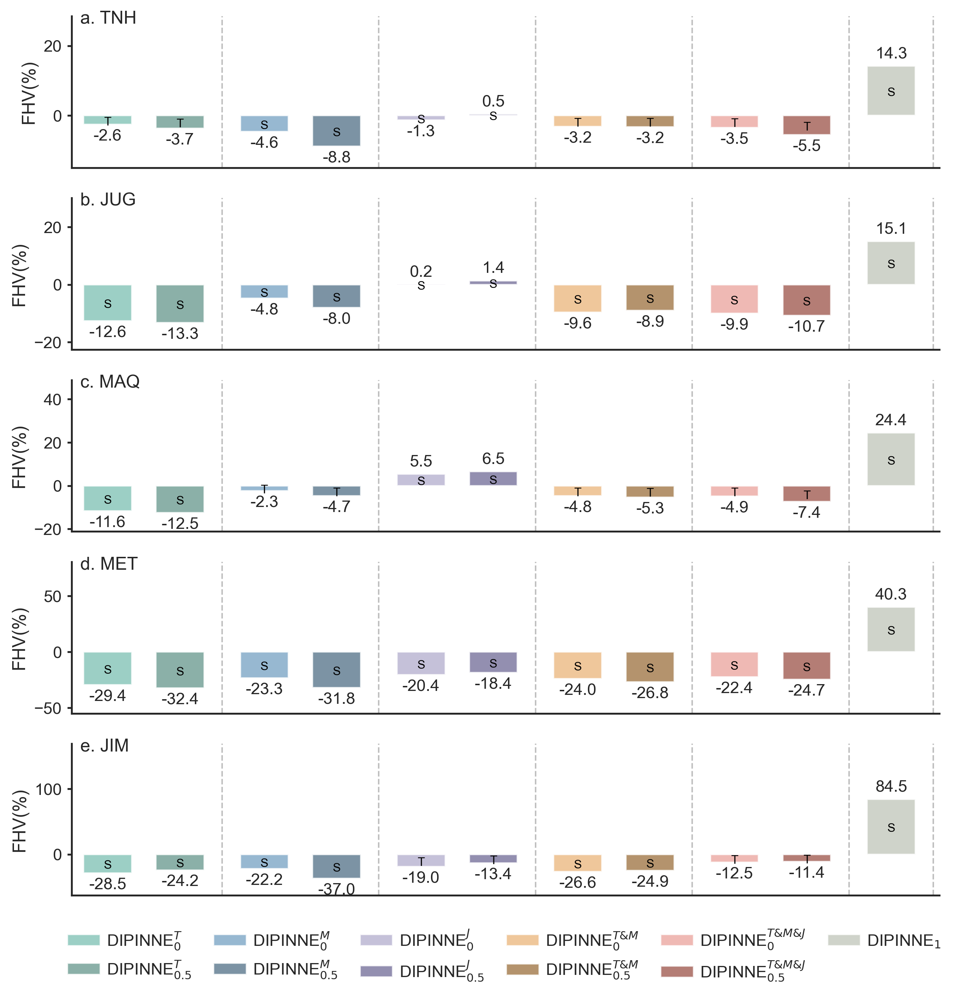

In [15]:
model_plt = ['DIPINNE_0^T', 'DIPINNE_0.5^T', 'DIPINNE_0^M', 'DIPINNE_0.5^M', 'DIPINNE_0^J', 'DIPINNE_0.5^J', 'DIPINNE_0^T&M', 'DIPINNE_0.5^T&M', 'DIPINNE_0^T&M&J', 'DIPINNE_0.5^T&M&J', 'DIPINNE_1']

metricUnit = dict(zip(['NSE', 'KGE', 'RMSE', 'FLV', 'FHV'], ['', '', '(mm/d)', '(%)', '(%)']))
for i, metricName in enumerate(metricUnit.keys()):
# for i, metricName in enumerate(['FLV', 'FHV']):
    fig, axes = plt.subplots(nrows=5, ncols=1, figsize=(9, 9), dpi=300)
    for k, station in enumerate(stations):
        yMax, yMin = -9999, 9999
        ax = axes[k]
        boxes = defaultdict()
        space, width = 0.1, 0.2
        for j, model in enumerate(model_plt):
            xTemp = np.array([(space + width) * (0.5 + j) + j // 2 * 0.5 * space])
            yTemp = np.array([modelMetric[model]['Q']['mean'][station][metricName]])
            yMax = yTemp.max() if yTemp.max() > yMax else yMax
            yMin = yTemp.min() if yTemp.min() < yMin else yMin
            rect = ax.bar(xTemp, yTemp, width, color=color_dict[model], label=legend_dict[model], alpha=0.8)
            ax.bar_label(rect, labels=[f'{yTemp[0]:.3f}'] if metricName not in ['FLV', 'FHV'] else [f'{yTemp[0]:.1f}'], label_type='edge', padding=3, fontsize=11)

        # ax.set_xlabel(station, labelpad=2.5)
        # ax.set_xlabel(station, labelpad=2.5)
        if metricName in ['NSE', 'r', 'KGE']:
            top = min(yMax * 1.6, 1.2)
            bottom = yMin * 0.8 if yMin > 0 else yMin * 1.3
        elif metricName in ['RMSE']:
            top = yMax * 1.3
            bottom = yMin * 0.8 if yMin > 0 else yMin * 1.3
        elif metricName in ['FLV']:
            top = max(yMax * 2, 50)
            bottom = yMin * 0.8 if yMin > 0 else yMin * 2
        else:
            top = max(yMax * 2, 10)
            bottom = yMin * 0.8 if yMin > 0 else yMin * 1.7

        ax.set_ylim(top=top, bottom=bottom)
        ax.set_xlim(left=0, right=3.6)
        ax.set_xticks([])

        # add scatter plot
        for j, model in enumerate(model_plt):
            xScatter = (space + width) * (0.5 + j) + j // 2 * 0.5 *space
            yScatter = modelMetric[model]['Q']['mean'][station][metricName]
            yScatter = (yScatter - max(bottom, 0)) * 0.5 + max(bottom, 0)
            ax.annotate(markers[model][station], xy=(xScatter, yScatter), xytext=(0, -1.5), ha='center', va='center', fontsize=8, color='black', textcoords='offset points')
            if j in [1, 3, 5, 7, 9, 10]:
                ax.axvline(x=xScatter + 0.75 * space + width / 2, color='grey', linestyle='--', alpha=0.5, linewidth=1)

        ax.tick_params(axis='y', length=3)  # adjust tick length
        ax.tick_params(axis='x', length=3, color='white')  # adjust tick length
        ax.spines['right'].set_visible(False)
        ax.spines['top'].set_visible(False)
        ax.annotate(f'{chr(97+k)}. {station}', xy=(0.01, 0.95), xycoords='axes fraction')
        # ax.grid(axis='y',ls='--',alpha=0.8)

        ax.set_ylabel(metricName + metricUnit[metricName])

    lines, labels = ax.get_legend_handles_labels()
    fig.legend(lines, labels, ncol=6, borderaxespad=0.1,
               bbox_to_anchor=(0.07, 0.03, 0.92, 0.01), mode='expand', columnspacing=1, frameon=False, handletextpad=0.4)
    # plt.annotate('T: Temporal test station   S: Spatial test station', xy=(0.8, 0.3), xycoords='figure fraction', ha='center')

    fig.tight_layout(rect=(0, 0.04, 1, 1))

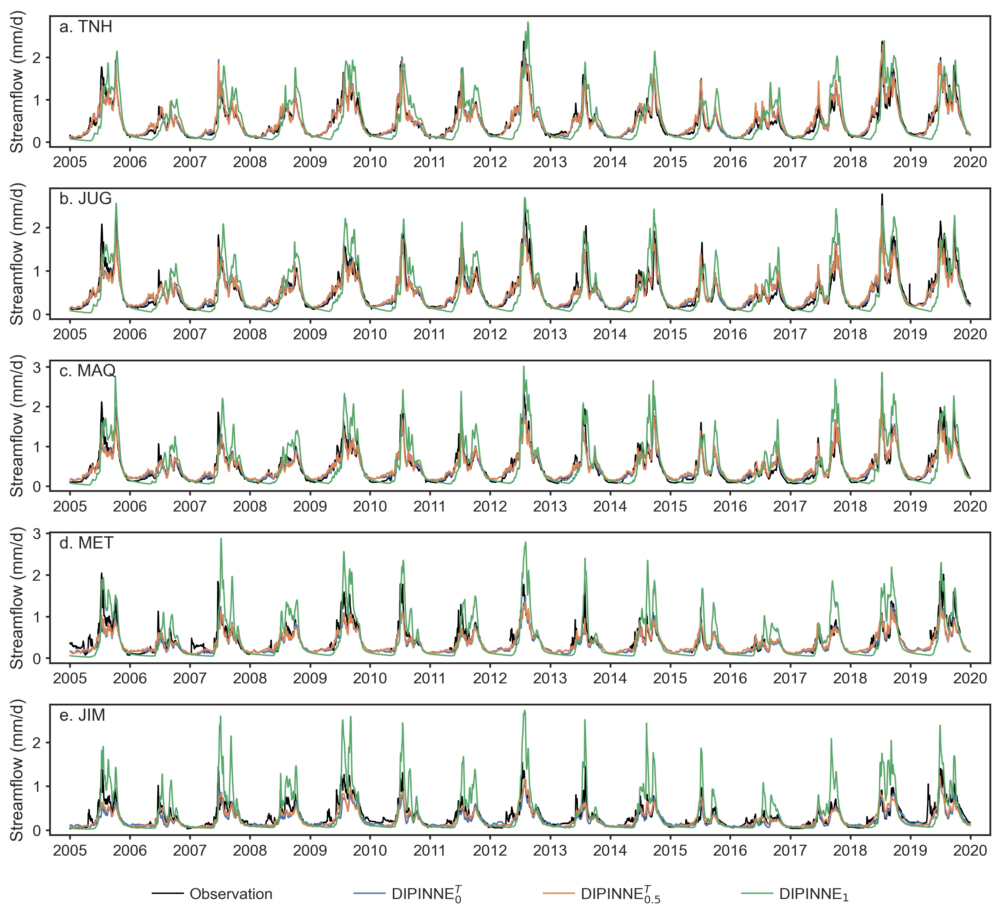

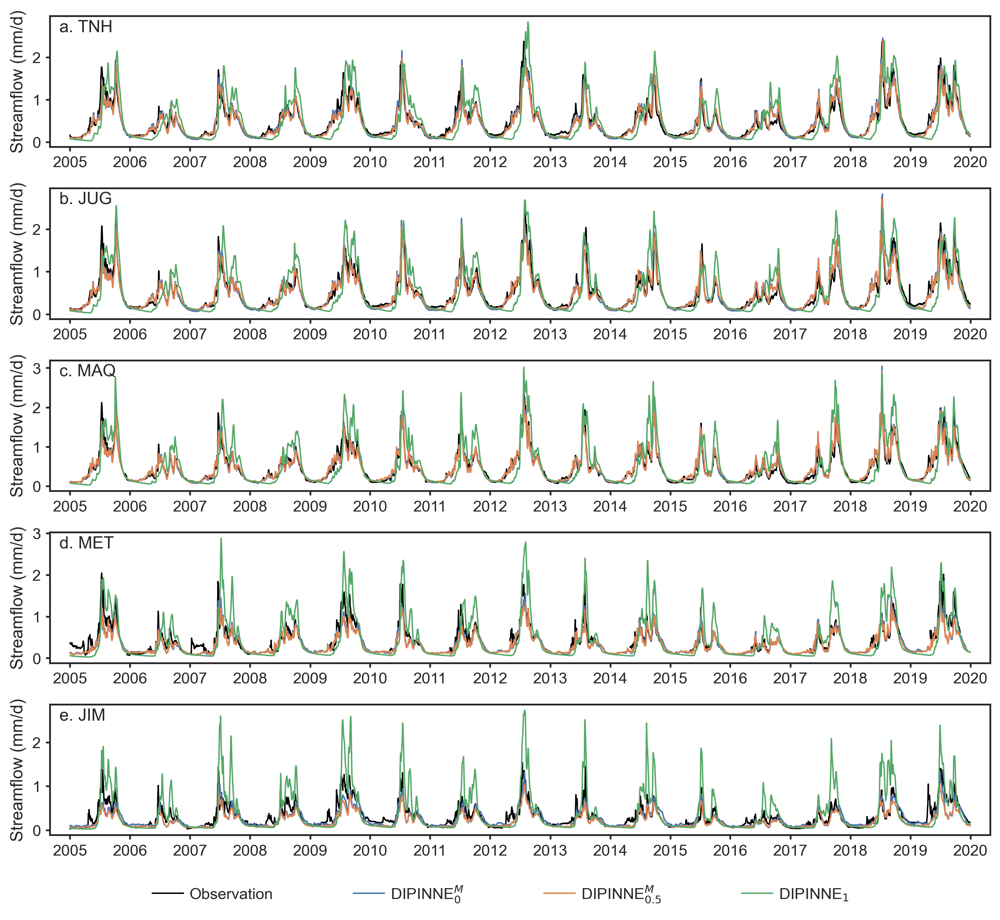

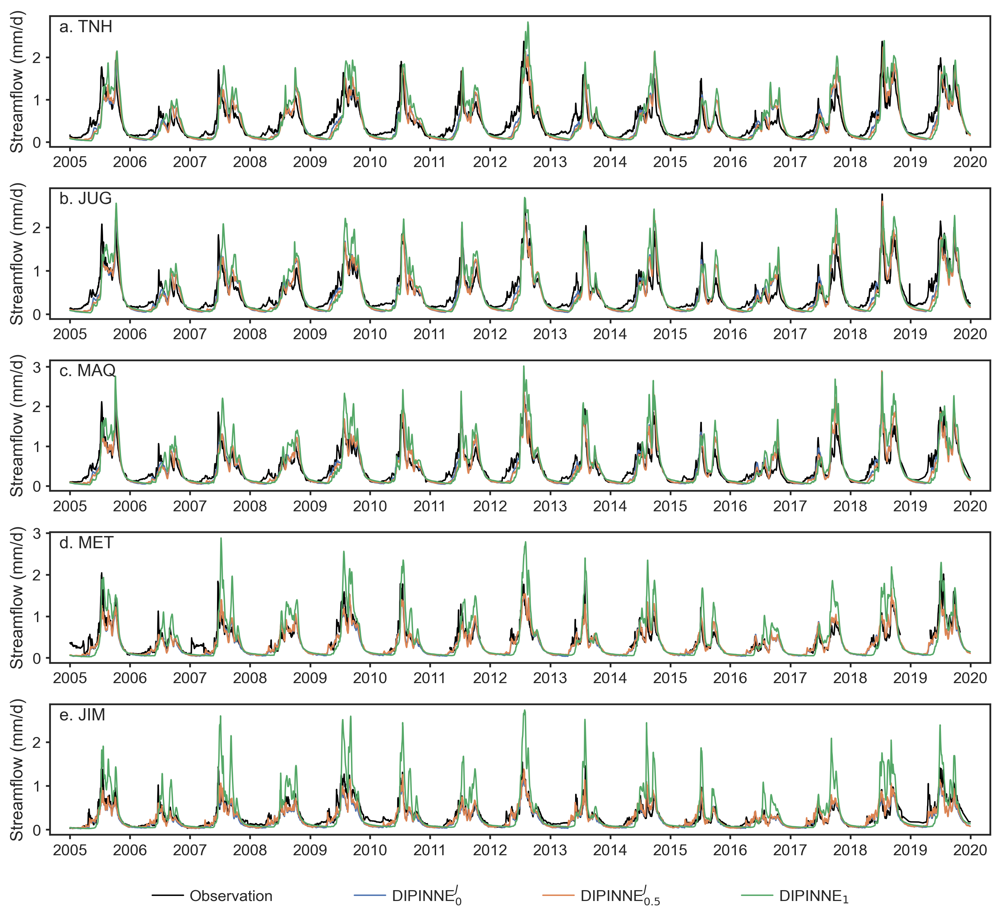

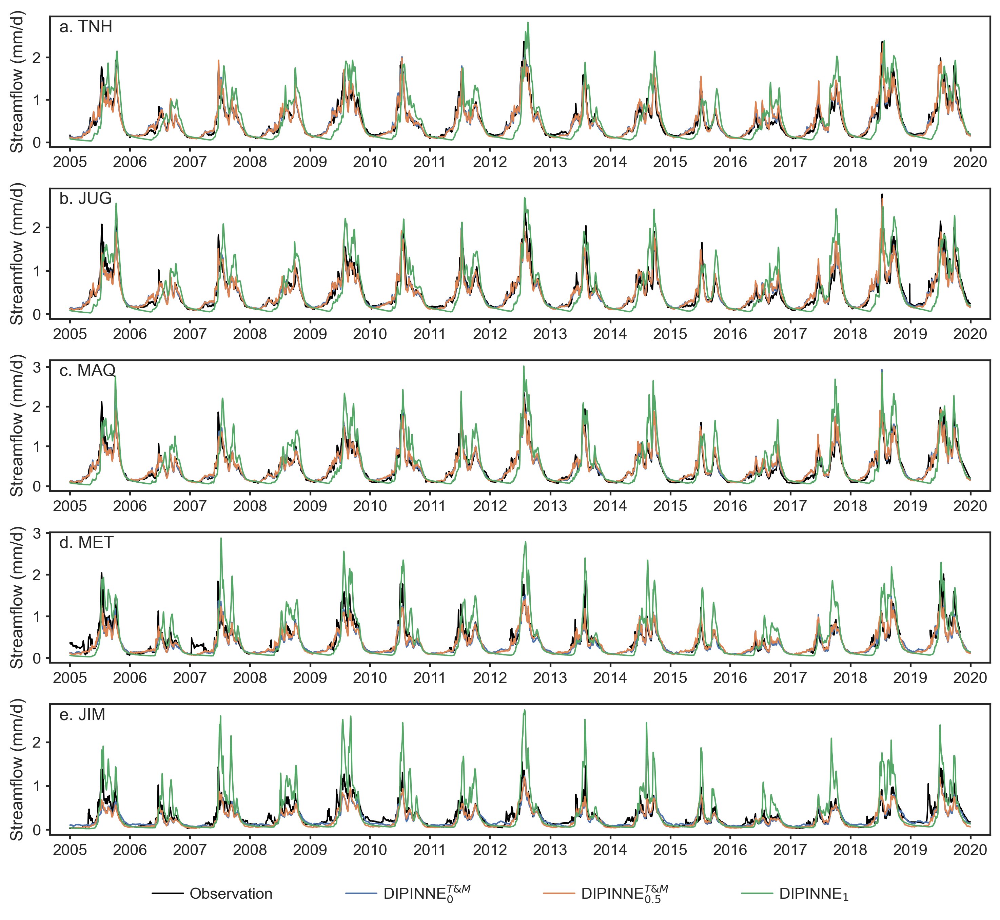

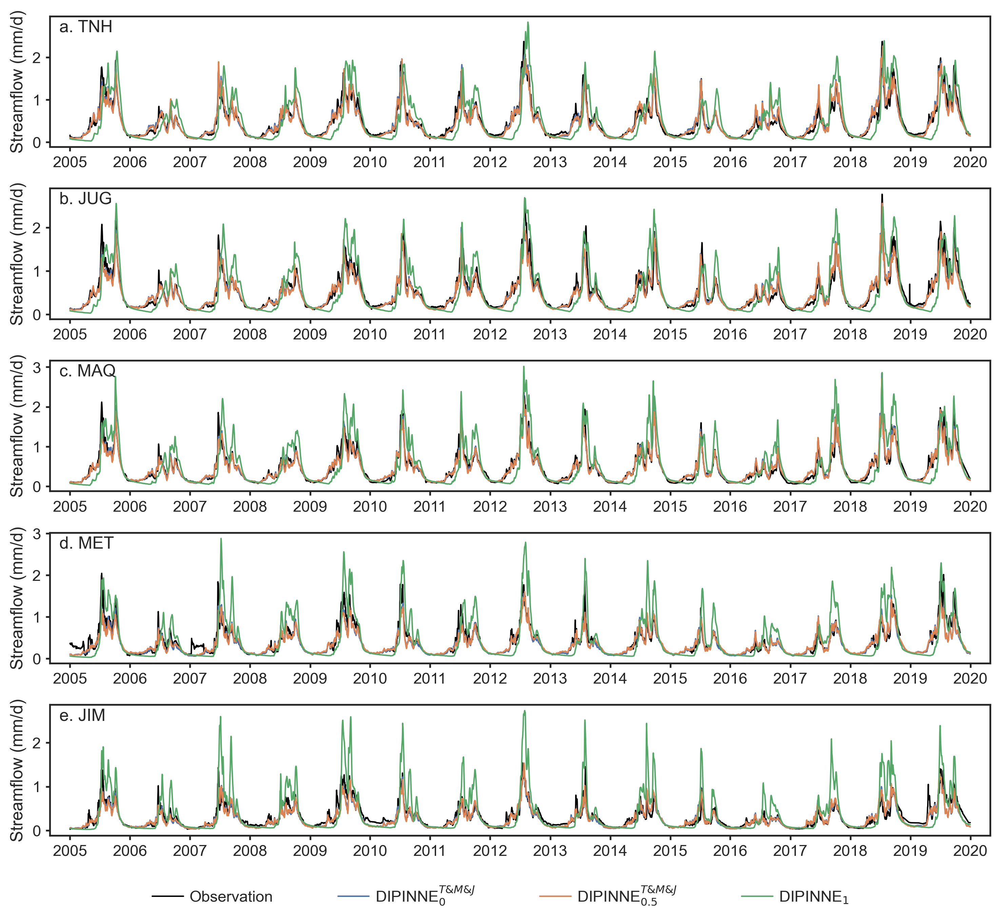

In [17]:
for i in range(0, 5):
    fig, axes = plt.subplots(nrows=5, ncols=1, figsize=(10, 9), dpi=300)
    # Get observed and simulated streamflow
    Q_dict = dict()
    tst_period = pd.date_range('2005-1-1', '2019-12-31')

    # get observed streamflow
    obs_Q = pd.read_csv('../data/streamflow.csv', index_col='DATE', parse_dates=True)
    Q_dict['Observation'] = obs_Q[obs_Q.index.isin(tst_period)]

    # get ensemble mean simulated streamflow
    model_tmp = [model_plt[2*i], model_plt[2*i+1], model_plt[-1]]
    for model in model_tmp:
        sim_Q = simulation[model]['mean']['Qr'].loc[:, [13, 45, 53, 35, 23, 0]]
        sim_Q.rename(columns={13: 'HHY', 45: 'JIM', 53: 'MET', 35: 'MAQ', 23: 'JUG', 0: 'TNH'}, inplace=True)
        sim_Q = sim_Q[sim_Q.index.isin(tst_period)]
        Q_dict[model] = sim_Q

    # convert unit to mm/d
    area = {'HHY': 20930, 'JIM': 45019, 'JUG': 98414, 'MAQ': 86048, 'MET': 59655, 'TNH': 121972}
    for station in stations:
        unit = 24 * 3600 / (area[station] * 1000)
        Q_dict['Observation'].loc[:, station] = Q_dict['Observation'].loc[:, station] * unit
        for model in model_tmp:
            Q_dict[model].loc[:, station] = Q_dict[model].loc[:, station] * unit
    color_tmp = dict(zip(model_tmp, sns.color_palette(n_colors=3, palette='deep')))
    for j, station in enumerate(stations):
        ax = axes[j]
        for k, v in Q_dict.items():
            if k == 'Observation':
                ax.plot(v.index, v[station], color='black', label='Observation', linewidth=1)
            else:
                ax.plot(v.index, v[station], color=color_tmp[k], label=legend_dict[k], linewidth=1)
        ax.set_ylabel('Streamflow (mm/d)')
        ax.tick_params(axis='both', length=3)  # adjust tick length
        ax.annotate(f'{chr(97+j)}. {station}', xy=(0.01, 0.88), xycoords='axes fraction')
        import matplotlib.dates as mdates
        dateFmt = mdates.DateFormatter('%Y')
        ax.xaxis.set_major_locator(mdates.YearLocator())
        # ax.tick_params(rotation=45, axis='x', length=3)
        ax.xaxis.set_major_formatter(dateFmt)
        ax.set_xlim(tst_period.min()-pd.DateOffset(months=4), tst_period.max()+pd.DateOffset(months=4))

    lines, labels = ax.get_legend_handles_labels()
    fig.legend(lines, labels, ncol=4, borderaxespad=0.1,
               bbox_to_anchor=(0.15, 0.03, 0.7, 0.01), mode='expand', columnspacing=1, frameon=False, handletextpad=0.4)
    fig.tight_layout(rect=(0, 0.04, 1, 1))


In [8]:
models = ['DIPINNE_0^T', 'DIPINNE_0.5^T', 'DIPINNE_0^M', 'DIPINNE_0.5^M', 'DIPINNE_0^J', 'DIPINNE_0.5^J', 'DIPINNE_0^T&M', 'DIPINNE_0.5^T&M', 'DIPINNE_0^T&M&J', 'DIPINNE_0.5^T&M&J', 'DIPINNE_1']

ensemble_stat = dict()
for station in stations:
    dfTemp = pd.DataFrame(index=['NSE_mean discharge', 'NSE_mean', 'NSE_std'], columns=models)
    seeds = ['178716', '211765', '668823', '759826', '808530', '908331']
    for model in models:
        dfTemp.loc['NSE_mean discharge', model] = modelMetric[model]['Q']['mean'][station]['NSE']
        ensemble_metric = np.array([modelMetric[model]['Q'][seed][station]['NSE'] for seed in seeds])
        dfTemp.loc['NSE_mean', model] = ensemble_metric.mean()
        dfTemp.loc['NSE_std', model] = ensemble_metric.std()
    ensemble_stat[station] = dfTemp

excel_writer = pd.ExcelWriter('ensemble_statistic.xlsx', engine='xlsxwriter')
for sheet_name, df in ensemble_stat.items():
    df.to_excel(excel_writer, sheet_name=sheet_name, index=True)
excel_writer.save()

### Scatter plots for streamflow

In [18]:
def evalFn(true: np.ndarray, pred: np.ndarray):
    # calculate nse
    numerator = np.sum((pred - true) ** 2)
    denominator = np.sum((true - np.mean(true)) ** 2)
    nse = 1 - numerator / denominator
    # calculate pearson's correlation coefficient
    r = np.corrcoef(pred, true)[0, 1]
    # calculate the percent bias
    pBias = 100 * (pred - true).sum() / true.sum()
    # calculate KGE
    beta = np.mean(pred) / np.mean(true)
    gamma = (np.std(pred) / np.mean(pred)) / (np.std(true) / np.mean(true))
    kge = 1 - np.sqrt((r - 1) ** 2 + (beta - 1) ** 2 + (gamma - 1) ** 2)
    # calculate RMSE
    rmse = np.sqrt(np.mean((pred - true) ** 2))
    # calculate log nse
    predLog, trueLog = np.log10(pred + 0.1), np.log10(true + 0.1)
    numerator = np.sum((predLog - trueLog) ** 2)
    denominator = np.sum((trueLog - np.mean(trueLog)) ** 2)
    nseLog = 1 - numerator / denominator
    return nse, r, pBias, kge, rmse, nseLog

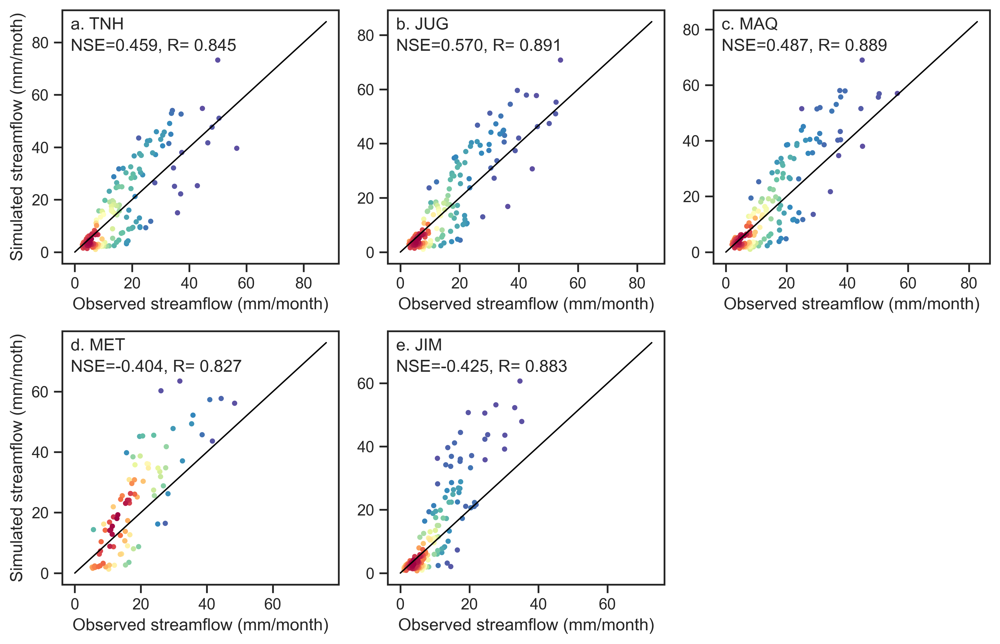

In [19]:
# plot scatters for monthly streamflow
# for model in color_dict.keys():
for model in ['DIPINNE_1']:
    tst_period = pd.date_range('2005-1-1', '2019-12-31')
    area = {'HHY': 20930, 'JIM': 45019, 'JUG': 98414, 'MAQ': 86048, 'MET': 59655, 'TNH': 121972}

    # get ensemble mean simulated streamflow
    sim_Q = simulation[model]['mean']['Qr'].loc[:, [13, 45, 53, 35, 23, 0]]
    sim_Q.rename(columns={13: 'HHY', 45: 'JIM', 53: 'MET', 35: 'MAQ', 23: 'JUG', 0: 'TNH'}, inplace=True)
    sim_Q = sim_Q[sim_Q.index.isin(tst_period)]
    # get observed streamflow
    obs_Q = pd.read_csv('../data/streamflow.csv', index_col='DATE', parse_dates=True)
    obs_Q = obs_Q[obs_Q.index.isin(tst_period)]

    # plot scatters
    fig = plt.figure(figsize=(10, 6.5), dpi=400)
    for i, station in enumerate(stations):
        unit = 24 * 3600 / (area[station] * 1000)
        pred, true = sim_Q.loc[:, station] * unit, obs_Q.loc[:, station] * unit
        if station == 'MET':
            pred = pred[(pred.index.month >= 5) & (pred.index.month <= 10)]
            true = true[(true.index.month >= 5) & (true.index.month <= 10)]
        # drop nan value
        pred.name, true.name = 'pred', 'true'
        dfTemp = pd.concat([pred, true], axis=1)
        dfTemp.dropna(inplace=True)
        dfTemp = dfTemp.groupby([dfTemp.index.year, dfTemp.index.month]).sum()
        nse, r, pbias, kge, rmse, nseLog = evalFn(true=dfTemp['true'].values, pred=dfTemp['pred'].values)

        # plot scatters
        ax = fig.add_subplot(2, 3, i+1)
        x, y = dfTemp['true'].values, dfTemp['pred'].values
        xy = np.vstack([x, y])
        z = gaussian_kde(xy)(xy)
        idx = z.argsort()
        x_plot, y_plot, z_plot = x[idx], y[idx], z[idx]
        ylim_max = max(x_plot.max(), y_plot.max())
        ax.plot(np.linspace(0, ylim_max * 1.2), np.linspace(0, ylim_max * 1.2), color='black', lw=1) # 1:1 line
        scatter = ax.scatter(x_plot, y_plot, c=z_plot, edgecolors=['None'], s=14, cmap='Spectral_r')

        # adjust format
        if i % 3 == 0:
            ax.set_ylabel('Simulated streamflow (mm/moth)')
        ax.set_xlabel('Observed streamflow (mm/month)')

        # annotation
        text = f'{chr(97+i)}. {station}\nNSE={nse:.3f}, R={r: .3f}'
        ax.annotate(text, xy=(0.03, 0.84), xycoords='axes fraction', linespacing=1.5)

        plt.tight_layout()

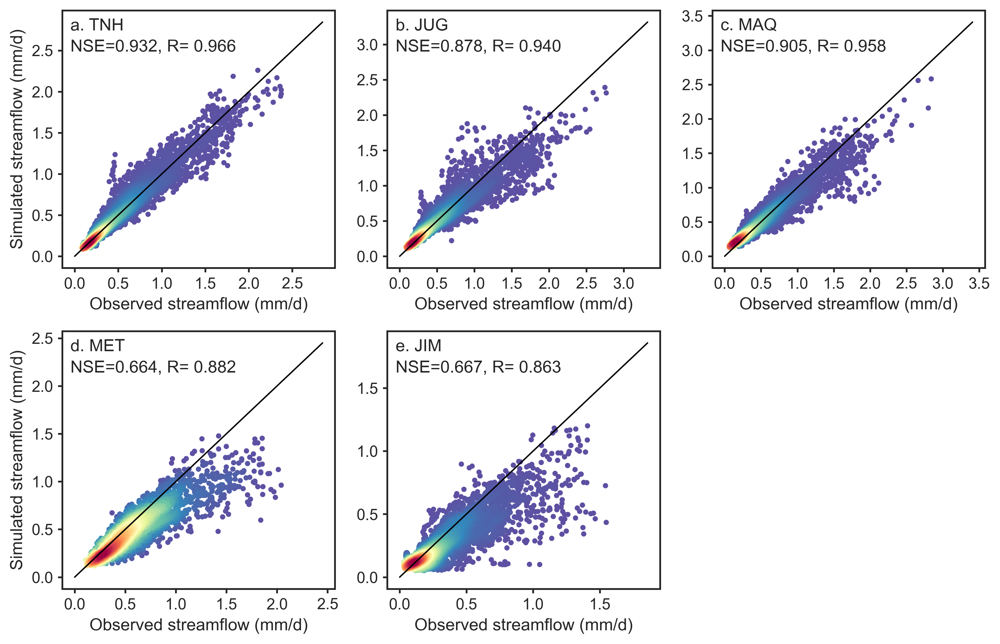

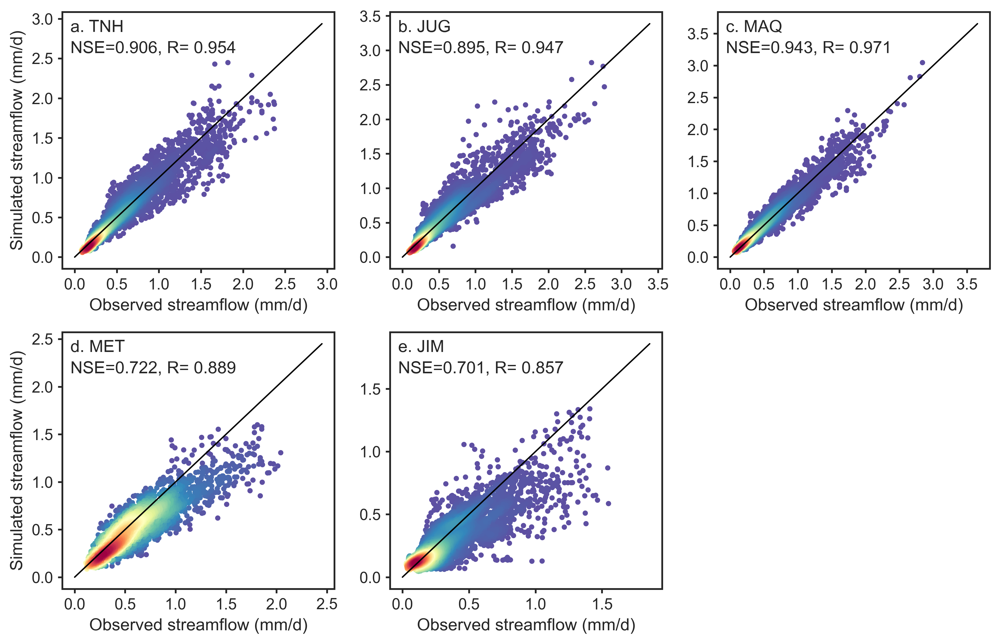

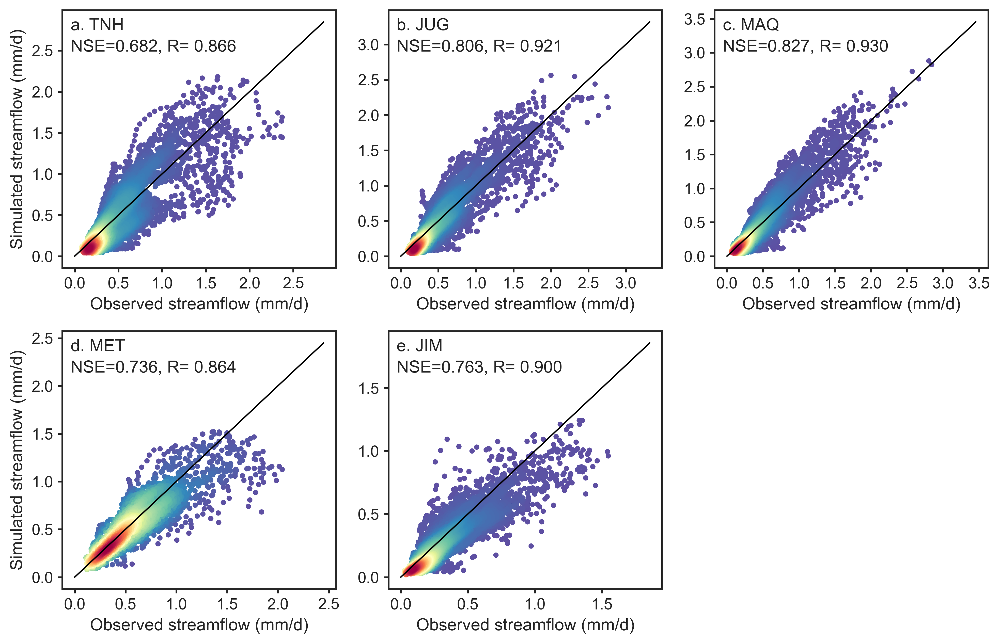

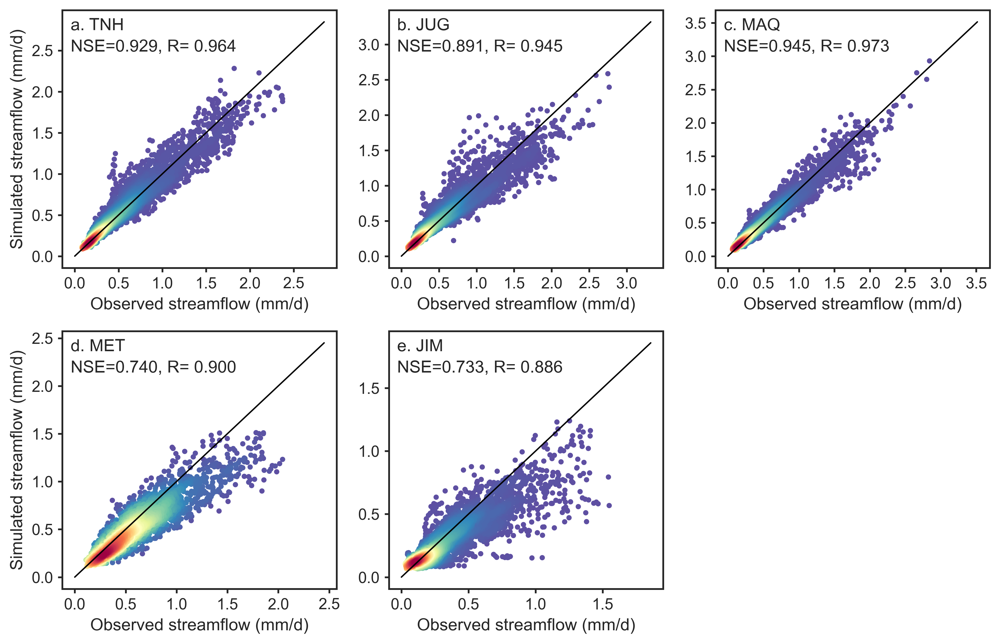

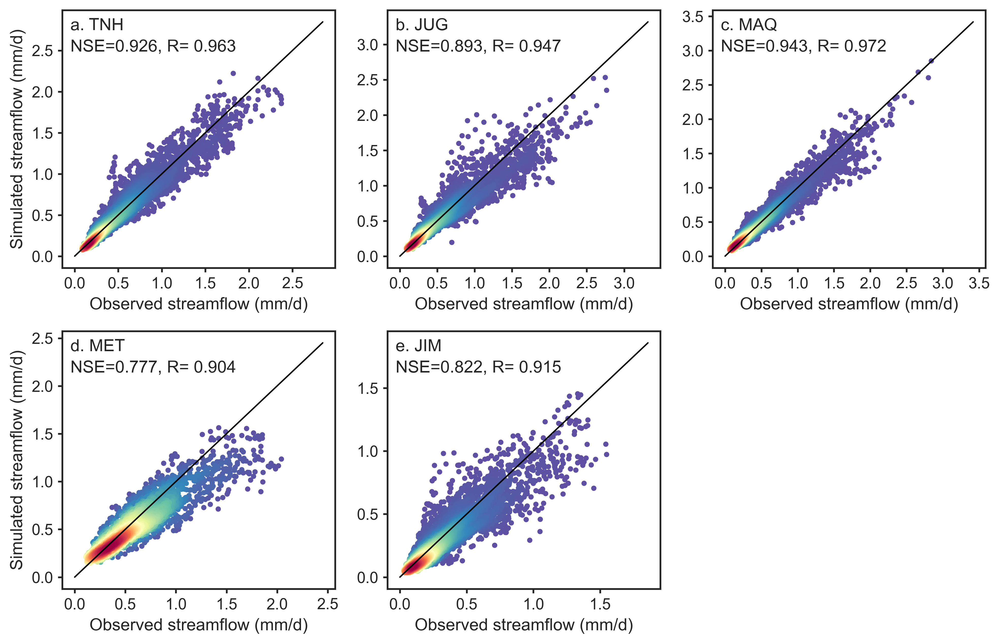

...

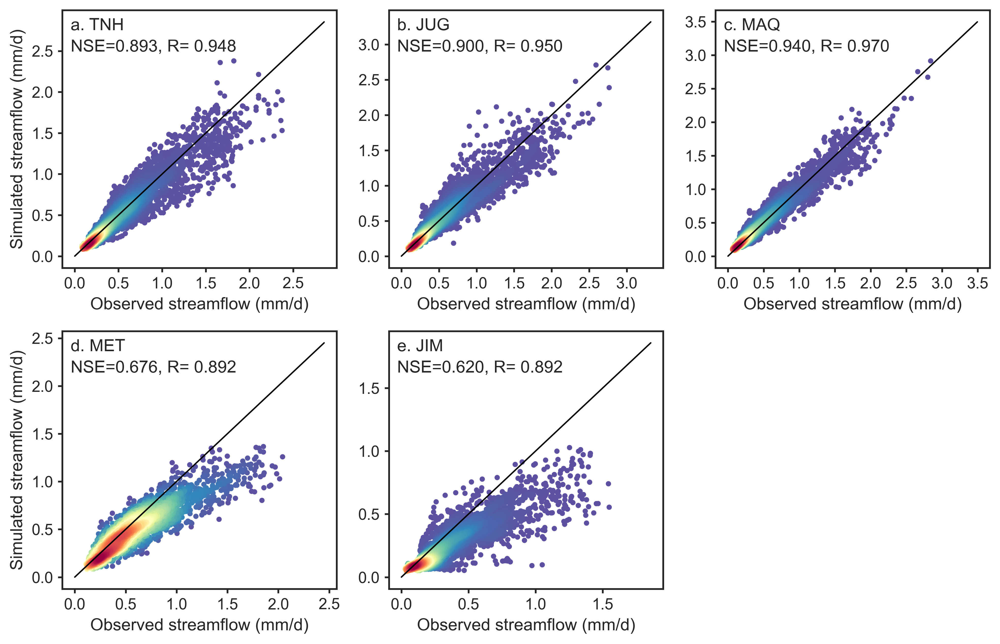

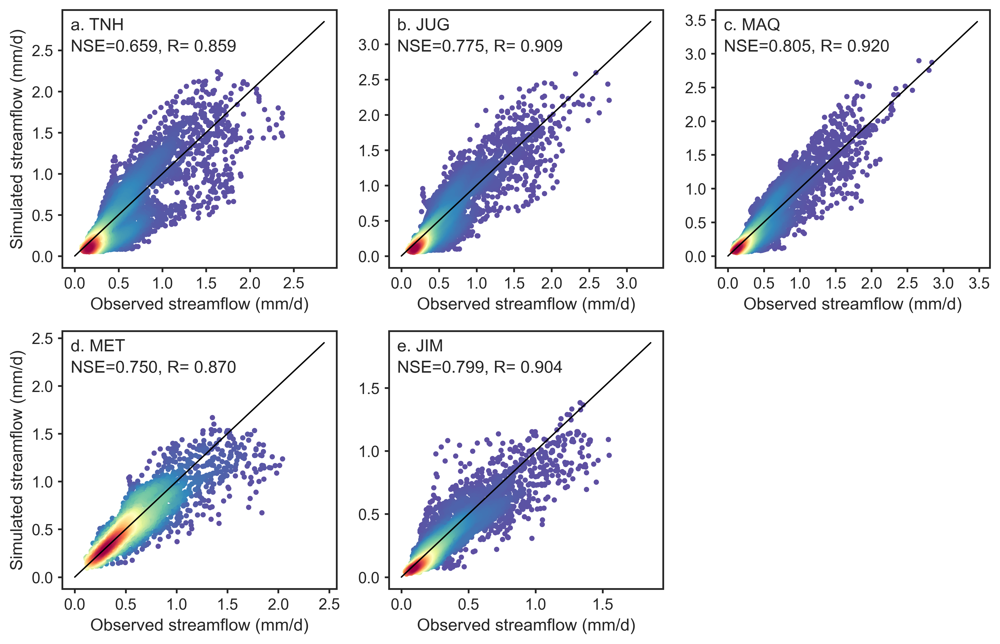

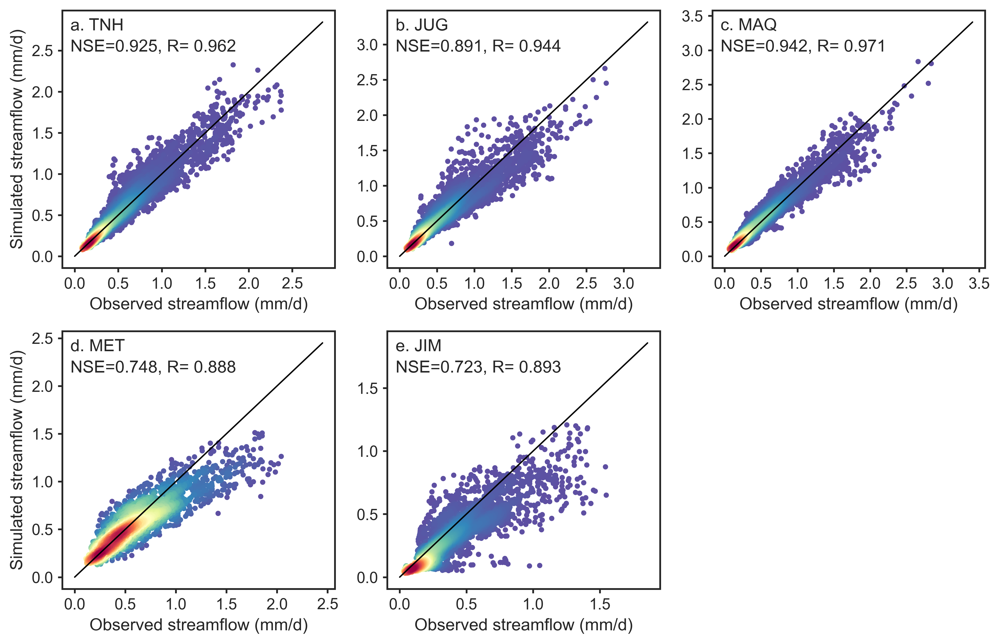

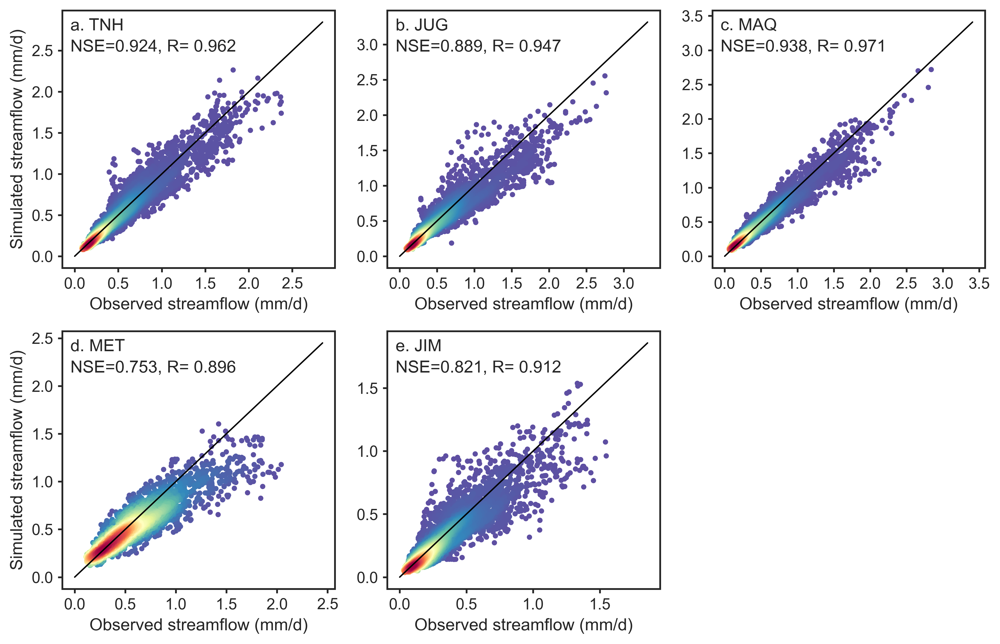

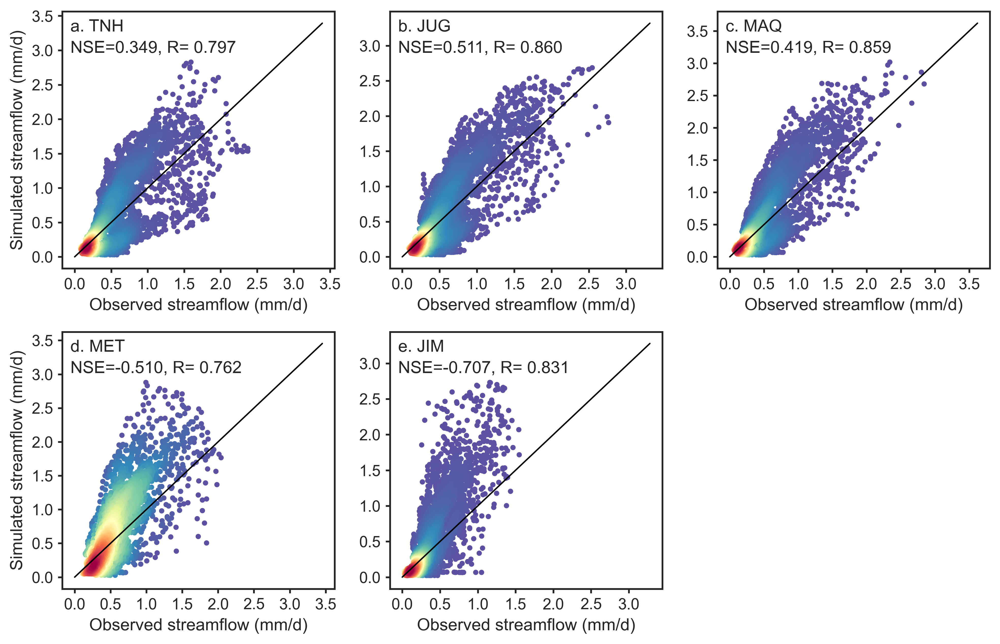

In [10]:
# set seaborn style
custom_params = {
    'xtick.major.size': 3,
    'ytick.major.size': 3,
}
sns.set_theme(style='ticks', rc=custom_params)

# plot scatters for streamflow
for model in color_dict.keys():
    tst_period = pd.date_range('2005-1-1', '2019-12-31')
    area = {'HHY': 20930, 'JIM': 45019, 'JUG': 98414, 'MAQ': 86048, 'MET': 59655, 'TNH': 121972}

    # get ensemble mean simulated streamflow
    sim_Q = simulation[model]['mean']['Qr'].loc[:, [13, 45, 53, 35, 23, 0]]
    sim_Q.rename(columns={13: 'HHY', 45: 'JIM', 53: 'MET', 35: 'MAQ', 23: 'JUG', 0: 'TNH'}, inplace=True)
    sim_Q = sim_Q[sim_Q.index.isin(tst_period)]
    # get observed streamflow
    obs_Q = pd.read_csv('../data/streamflow.csv', index_col='DATE', parse_dates=True)
    obs_Q = obs_Q[obs_Q.index.isin(tst_period)]

    # plot scatters
    fig = plt.figure(figsize=(10, 6.5), dpi=400)
    for i, station in enumerate(stations):
        unit = 24 * 3600 / (area[station] * 1000)
        pred, true = sim_Q.loc[:, station] * unit, obs_Q.loc[:, station] * unit
        if station == 'MET':
            pred = pred[(pred.index.month >= 5) & (pred.index.month <= 10)]
            true = true[(true.index.month >= 5) & (true.index.month <= 10)]
        # drop nan value
        pred.name, true.name = 'pred', 'true'
        dfTemp = pd.concat([pred, true], axis=1)
        dfTemp.dropna(inplace=True)
        nse, r, pbias, kge, rmse, nseLog = evalFn(true=dfTemp['true'].values, pred=dfTemp['pred'].values)

        # plot scatters
        ax = fig.add_subplot(2, 3, i+1)
        x, y = dfTemp['true'].values, dfTemp['pred'].values
        xy = np.vstack([x, y])
        z = gaussian_kde(xy)(xy)
        idx = z.argsort()
        x_plot, y_plot, z_plot = x[idx], y[idx], z[idx]
        ylim_max = max(x_plot.max(), y_plot.max())
        ax.plot(np.linspace(0, ylim_max * 1.2), np.linspace(0, ylim_max * 1.2), color='black', lw=1) # 1:1 line
        scatter = ax.scatter(x_plot, y_plot, c=z_plot, edgecolors=['None'], s=14, cmap='Spectral_r')

        # adjust format
        if i % 3 == 0:
            ax.set_ylabel('Simulated streamflow (mm/d)')
        ax.set_xlabel('Observed streamflow (mm/d)')
        ax.xaxis.set_major_locator(ticker.MultipleLocator(0.5))
        ax.yaxis.set_major_locator(ticker.MultipleLocator(0.5))

        # annotation
        text = f'{chr(97+i)}. {station}\nNSE={nse:.3f}, R={r: .3f}'
        ax.annotate(text, xy=(0.03, 0.84), xycoords='axes fraction', linespacing=1.5)

        plt.tight_layout()

### Calculate and visualize the trend of streamflow

In [11]:
# calculate trend of streamflow
import pymannkendall as mk

model_plt = ['DIPINNE_0^T', 'DIPINNE_0.5^T', 'DIPINNE_0^M', 'DIPINNE_0.5^M', 'DIPINNE_0^J', 'DIPINNE_0.5^J', 'DIPINNE_0^T&M', 'DIPINNE_0.5^T&M', 'DIPINNE_0^T&M&J', 'DIPINNE_0.5^T&M&J']
trend_dict = defaultdict(lambda: defaultdict(dict))
for model in color_dict.keys():
    tst_period = pd.date_range('1995-1-1', '2019-12-31')
    area = {'HHY': 20930, 'JIM': 45019, 'JUG': 98414, 'MAQ': 86048, 'MET': 59655, 'TNH': 121972}

    # get ensemble mean simulated streamflow
    sim_Q = simulation[model]['mean']['Qr'].loc[:, [13, 45, 53, 35, 23, 0]]
    sim_Q.rename(columns={13: 'HHY', 45: 'JIM', 53: 'MET', 35: 'MAQ', 23: 'JUG', 0: 'TNH'}, inplace=True)
    sim_Q = sim_Q[sim_Q.index.isin(tst_period)]
    # get observed streamflow
    obs_Q = pd.read_csv('../data/streamflow.csv', index_col='DATE', parse_dates=True)
    obs_Q = obs_Q[obs_Q.index.isin(tst_period)]

    # plot scatters
    for i, station in enumerate(stations):
        unit = 24 * 3600 / (area[station] * 1000)
        pred, true = sim_Q.loc[:, station] * unit, obs_Q.loc[:, station] * unit
        if station == 'MET':
            pred = pred[(pred.index.month >= 5) & (pred.index.month <= 10)]
            true = true[(true.index.month >= 5) & (true.index.month <= 10)]
        # drop nan value
        pred.name, true.name = 'pred', 'true'
        dfTemp = pd.concat([pred, true], axis=1)
        dfTemp.dropna(inplace=True)

        pred = dfTemp.loc[:, 'pred'].groupby(dfTemp.index.year).sum()
        true = dfTemp.loc[:, 'true'].groupby(dfTemp.index.year).sum()

        _, _, p, _, _, _, _, slope, intercept = mk.original_test(true.values)
        trend_dict[model][station]['obs'] = (slope, intercept, p)
        _, _, p, _, _, _, _, slope, intercept = mk.original_test(pred.values)
        trend_dict[model][station]['sim'] = (slope, intercept, p)

trend_df = pd.DataFrame(index=stations, columns=['Observation'] + model_plt)
for station in stations:
    for model in model_plt:
        trend_df.loc[station, model] = trend_dict[model][station]['sim'][0]
    trend_df.loc[station, 'Observation'] = trend_dict[model][station]['obs'][0]
# trend_df.to_csv('trend_streamflow.csv')


## Plot ensemble mean metrics for LAI

In [12]:
# Split the Spectral colormap into two parts: YellowGreen and YellowRed

from matplotlib.colors import LinearSegmentedColormap
# Get YellowGreen color map
cmap_spectral = plt.get_cmap('Spectral')
N = cmap_spectral.N
colors_spectral = cmap_spectral(np.linspace(0, 1, N))
mid_point = N // 2
yeGr = colors_spectral[mid_point:]
yeGr = LinearSegmentedColormap.from_list('YellowGreen', yeGr)

# Get YellowRed color map
cmap_spectral = plt.get_cmap('Spectral_r')
N = cmap_spectral.N
colors_spectral = cmap_spectral(np.linspace(0, 1, N))
mid_point = N // 2
yeRed = colors_spectral[mid_point:]
yeRed = LinearSegmentedColormap.from_list('YellowRed', yeRed)

### Plot spatial distribution of LAI and its metrics

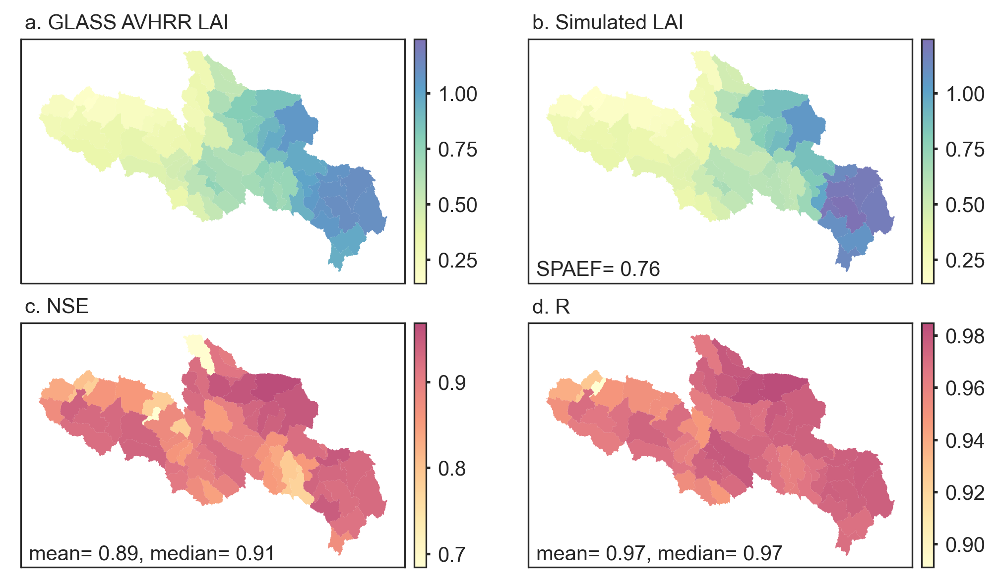

In [13]:
basins = gpd.read_file('../data/sub-basins/watershed.shp')
model_plt = ['DIPINNE_1']

for model in model_plt:
    # get observed LAI
    tst_period = pd.date_range('2005-1-1', '2018-12-31')
    df_obs = pd.read_csv('../data/LAI.csv', index_col=0, header=0, parse_dates=True)
    df_obs = df_obs[df_obs.index.isin(tst_period)]

    # resample simulated LAI to match the observed LAI
    sim_LAI = simulation[model]['mean']['LAI']
    sim_LAI.rename(columns={i: f'basin_{i}' for i in range(0, 69)}, inplace=True)
    df_sim = pd.DataFrame(index=df_obs.index, columns=df_obs.columns, dtype='float')
    for i in range(len(df_obs.index)):
        if i == len(df_obs.index) - 1:
            start_date = df_obs.index[i]
            df_sim.loc[start_date] = sim_LAI.loc[start_date:, :].mean(axis=0)
        else:
            start_date = df_obs.index[i]
            end_date = df_obs.index[i + 1]
            df_sim.loc[start_date] = sim_LAI.loc[start_date:end_date, :].mean(axis=0)

    fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(7, 4), dpi=300)

    # calculate data to plot
    basins.loc[:, 'GLASS AVHRR LAI'] = df_obs.mean(axis=0).values
    basins.loc[:, 'Simulated LAI'] = df_sim.mean(axis=0).values
    basins.loc[:, 'NSE'] = modelMetric[model]['LAI']['mean']['NSE']
    basins.loc[:, 'R'] = modelMetric[model]['LAI']['mean']['R']

    for j, item in enumerate(['GLASS AVHRR LAI', 'Simulated LAI', 'NSE', 'R']):
        cmap = yeGr if j < 2 else yeRed
        ax = axes[j//2, j%2]
        if item in ['GLASS AVHRR LAI', 'Simulated LAI']:
            vmin = min(basins.loc[:, 'GLASS AVHRR LAI'].min(), basins.loc[:, 'Simulated LAI'].min())
            vmax = max(basins.loc[:, 'GLASS AVHRR LAI'].max(), basins.loc[:, 'Simulated LAI'].max())
            basins.plot(column=item, ax=ax, cmap=cmap, edgecolor='None', linewidth=0.1, vmin=vmin, vmax=vmax, alpha=0.8)
        else:
            vmin, vmax = basins.loc[:, item].values.min(), basins.loc[:, item].values.max()
            basins.plot(column=item, ax=ax, cmap=cmap, edgecolor='None', linewidth=0.1, vmin=vmin, vmax=vmax, alpha=0.7)

        ax.set_xticks([])
        ax.set_yticks([])

        # Set axis spines properties
        lw = 0.8
        ax.spines['top'].set_linewidth(lw)  # Top spine thickness
        ax.spines['bottom'].set_linewidth(lw)  # Bottom spine thickness
        ax.spines['left'].set_linewidth(lw)  # Left spine thickness
        ax.spines['right'].set_linewidth(lw)  # Right spine thickness

        ax.annotate(f'{chr(97+j)}. {item}', xy=(0.01, 1.04), xycoords='axes fraction', fontsize=10)
        # calculate spatial similarity
        if item == 'Simulated LAI':
            obs, sim = basins.loc[:, 'GLASS AVHRR LAI'].values, basins.loc[:, item].values
            alpha = np.corrcoef(obs, sim)[0, 1]
            beta = variation(sim) / variation(obs)
            bins = int(np.around(math.sqrt(len(obs)), 0))
            hobs, _ = np.histogram(zscore(obs),bins)
            hsim, _ = np.histogram(zscore(sim),bins)
            gamma = np.minimum(hobs, hsim).sum() / hobs.sum()
            spaEF = 1 - np.sqrt((alpha - 1) ** 2 + (beta - 1) ** 2 + (gamma - 1) ** 2)
            ax.annotate(f'SPAEF={spaEF: .2f}', xy=(0.02, 0.03), xycoords='axes fraction', fontsize=10)
        elif item in ['NSE', 'R']:
            mean, median = basins.loc[:, item].mean(), basins.loc[:, item].median()
            ax.annotate(f'mean={mean: .2f}, median={median: .2f}', xy=(0.02, 0.03), xycoords='axes fraction', fontsize=10)
        norm = cm.Normalize(vmin=vmin, vmax=vmax)
        sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
        if item in ['GLASS AVHRR LAI', 'Simulated LAI']:
            cbar = plt.colorbar(sm, ax=ax, orientation='vertical', shrink=1, pad=0.02, alpha=0.8)
        else:
            cbar = plt.colorbar(sm, ax=ax, orientation='vertical', shrink=1, pad=0.02, alpha=0.7)

        cbar.ax.tick_params(direction='out', length=2, labelsize=10)
        cbar.outline.set_linewidth(lw)

    plt.subplots_adjust(wspace=0.05, hspace=0.01)
    plt.tight_layout()

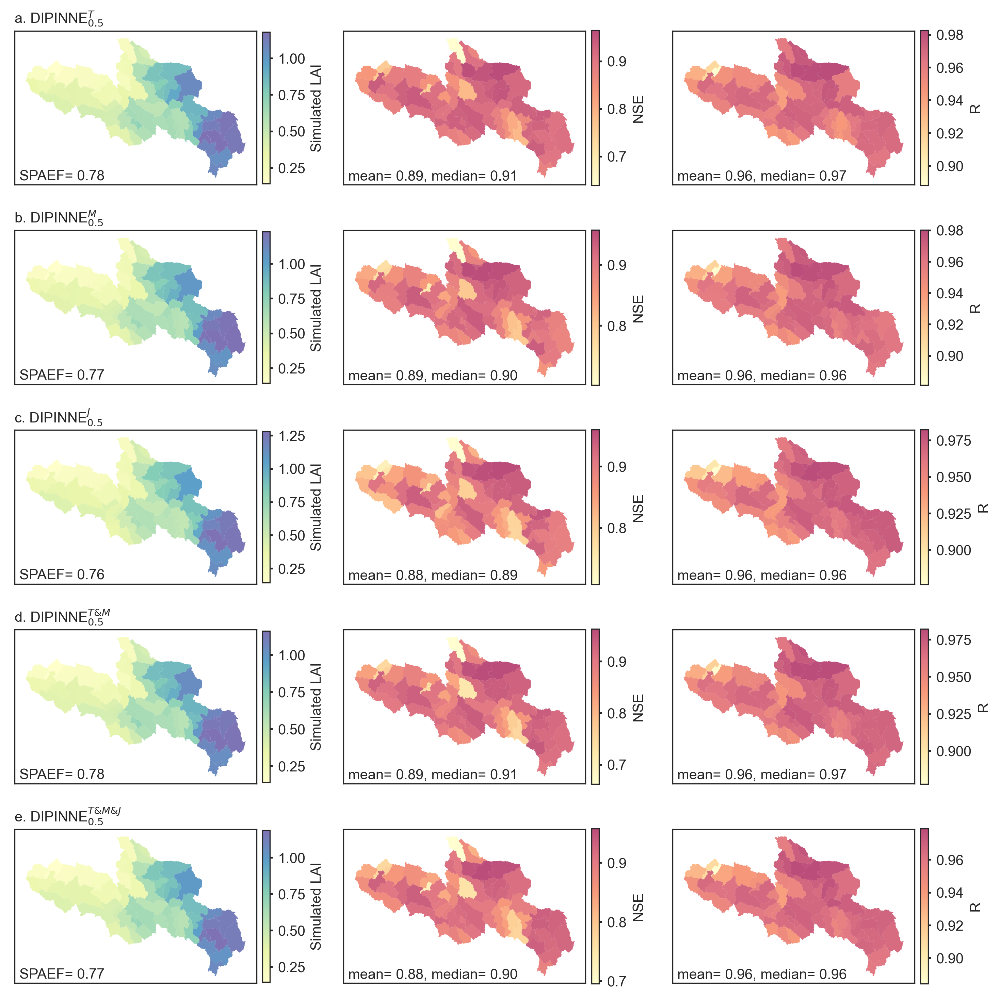

In [14]:
basins = gpd.read_file('../data/sub-basins/watershed.shp')
model_plt = ['DIPINNE_0.5^T', 'DIPINNE_0.5^M', 'DIPINNE_0.5^J', 'DIPINNE_0.5^T&M', 'DIPINNE_0.5^T&M&J']

fig, axes = plt.subplots(nrows=5, ncols=3, figsize=(10, 10), dpi=300)
for m, model in enumerate(model_plt):
    # get observed LAI
    tst_period = pd.date_range('2005-1-1', '2018-12-31')
    df_obs = pd.read_csv('../data/LAI.csv', index_col=0, header=0, parse_dates=True)
    df_obs = df_obs[df_obs.index.isin(tst_period)]

    # resample simulated LAI to match the observed LAI
    sim_LAI = simulation[model]['mean']['LAI']
    sim_LAI.rename(columns={i: f'basin_{i}' for i in range(0, 69)}, inplace=True)
    df_sim = pd.DataFrame(index=df_obs.index, columns=df_obs.columns, dtype='float')
    for i in range(len(df_obs.index)):
        if i == len(df_obs.index) - 1:
            start_date = df_obs.index[i]
            df_sim.loc[start_date] = sim_LAI.loc[start_date:, :].mean(axis=0)
        else:
            start_date = df_obs.index[i]
            end_date = df_obs.index[i + 1]
            df_sim.loc[start_date] = sim_LAI.loc[start_date:end_date, :].mean(axis=0)


    # calculate data to plot
    basins.loc[:, 'GLASS AVHRR LAI'] = df_obs.mean(axis=0).values
    basins.loc[:, 'Simulated LAI'] = df_sim.mean(axis=0).values
    basins.loc[:, 'NSE'] = modelMetric[model]['LAI']['mean']['NSE']
    basins.loc[:, 'R'] = modelMetric[model]['LAI']['mean']['R']

    for j, item in enumerate(['Simulated LAI', 'NSE', 'R']):
        cmap = yeGr if j < 1 else yeRed
        ax = axes[m, j]
        if item in ['GLASS AVHRR LAI', 'Simulated LAI']:
            vmin = min(basins.loc[:, 'GLASS AVHRR LAI'].min(), basins.loc[:, 'Simulated LAI'].min())
            vmax = max(basins.loc[:, 'GLASS AVHRR LAI'].max(), basins.loc[:, 'Simulated LAI'].max())
            basins.plot(column=item, ax=ax, cmap=cmap, edgecolor='None', linewidth=0.1, vmin=vmin, vmax=vmax, alpha=0.8)
        else:
            vmin, vmax = basins.loc[:, item].values.min(), basins.loc[:, item].values.max()
            basins.plot(column=item, ax=ax, cmap=cmap, edgecolor='None', linewidth=0.1, vmin=vmin, vmax=vmax, alpha=0.7)

        ax.set_xticks([])
        ax.set_yticks([])

        # Set axis spines properties
        lw = 0.8
        ax.spines['top'].set_linewidth(lw)  # Top spine thickness
        ax.spines['bottom'].set_linewidth(lw)  # Bottom spine thickness
        ax.spines['left'].set_linewidth(lw)  # Left spine thickness
        ax.spines['right'].set_linewidth(lw)  # Right spine thickness

        if j == 0:
            ax.annotate(f'{chr(97+m)}. {legend_dict[model]}', xy=(0.0, 1.05), xycoords='axes fraction', fontsize=10)
        # calculate spatial similarity
        if item == 'Simulated LAI':
            obs, sim = basins.loc[:, 'GLASS AVHRR LAI'].values, basins.loc[:, item].values
            alpha = np.corrcoef(obs, sim)[0, 1]
            beta = variation(sim) / variation(obs)
            bins = int(np.around(math.sqrt(len(obs)), 0))
            hobs, _ = np.histogram(zscore(obs),bins)
            hsim, _ = np.histogram(zscore(sim),bins)
            gamma = np.minimum(hobs, hsim).sum() / hobs.sum()
            spaEF = 1 - np.sqrt((alpha - 1) ** 2 + (beta - 1) ** 2 + (gamma - 1) ** 2)
            ax.annotate(f'SPAEF={spaEF: .2f}', xy=(0.02, 0.03), xycoords='axes fraction', fontsize=10)
        elif item in ['NSE', 'R']:
            mean, median = basins.loc[:, item].mean(), basins.loc[:, item].median()
            ax.annotate(f'mean={mean: .2f}, median={median: .2f}', xy=(0.02, 0.03), xycoords='axes fraction', fontsize=10)
        norm = cm.Normalize(vmin=vmin, vmax=vmax)
        sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
        if item in ['GLASS AVHRR LAI', 'Simulated LAI']:
            cbar = plt.colorbar(sm, ax=ax, orientation='vertical', shrink=0.86, pad=0.02, alpha=0.8)
        else:
            cbar = plt.colorbar(sm, ax=ax, orientation='vertical', shrink=0.88, pad=0.02, alpha=0.7)
        cbar.ax.set_ylabel(f'{item}', fontsize=10)
        cbar.ax.tick_params(direction='out', length=2, labelsize=10)
        cbar.outline.set_linewidth(lw)

plt.subplots_adjust(wspace=0.05, hspace=0.01)
plt.tight_layout()

### Plot the trend of LAI for 69 sub-basins

### Plot scatters for growing season LAI across 69 sub-basins

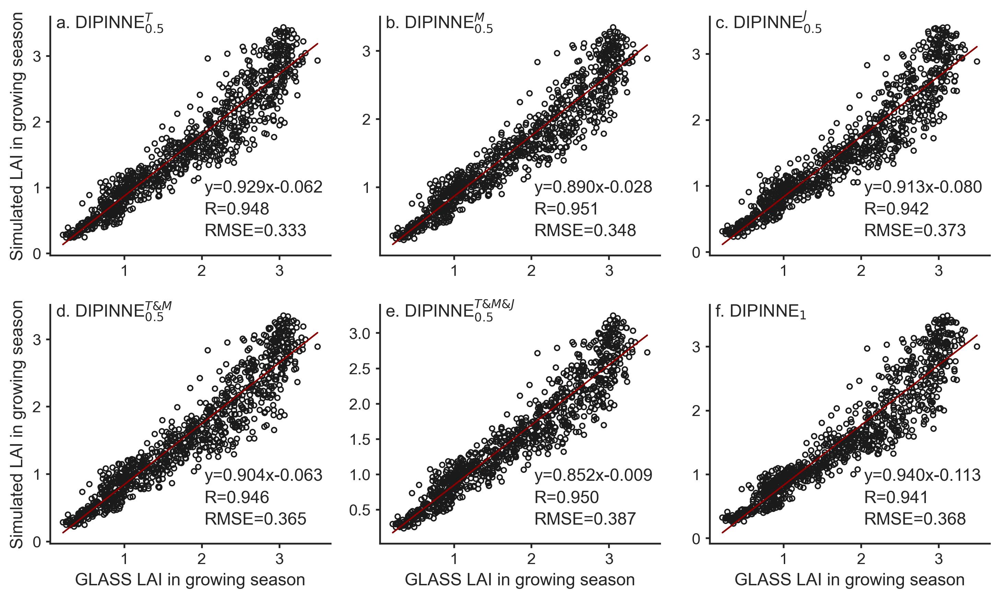

In [15]:
# plot scatters
model_plt = ['DIPINNE_0.5^T', 'DIPINNE_0.5^M', 'DIPINNE_0.5^J', 'DIPINNE_0.5^T&M', 'DIPINNE_0.5^T&M&J', 'DIPINNE_1']

fig = plt.figure(figsize=(10, 6), dpi=300)
for num, model in enumerate(model_plt):
    # get observed LAI
    tst_period = pd.date_range('2005-1-1', '2018-12-31')
    df_obs = pd.read_csv('../data/LAI.csv', index_col=0, header=0, parse_dates=True)
    df_obs = df_obs[df_obs.index.isin(tst_period)]

    # resample simulated LAI to match the observed LAI
    sim_LAI = simulation[model]['mean']['LAI']
    sim_LAI.rename(columns={i: f'basin_{i}' for i in range(0, 69)}, inplace=True)
    df_sim = pd.DataFrame(index=df_obs.index, columns=df_obs.columns, dtype='float')
    for i in range(len(df_obs.index)):
        if i == len(df_obs.index) - 1:
            start_date = df_obs.index[i]
            df_sim.loc[start_date] = sim_LAI.loc[start_date:, :].mean(axis=0)
        else:
            start_date = df_obs.index[i]
            end_date = df_obs.index[i + 1]
            df_sim.loc[start_date] = sim_LAI.loc[start_date:end_date, :].mean(axis=0)
    # get mean growing season LAI for growing
    gs_during = [7, 8]
    df_gs_sim = df_sim[(df_sim.index.month >= gs_during[0]) & (df_sim.index.month <= gs_during[-1])]
    df_gs_obs = df_obs[(df_obs.index.month >= gs_during[0]) & (df_obs.index.month <= gs_during[-1])]
    y_sim = df_gs_sim.groupby(df_gs_sim.index.year).mean()
    y_obs = df_gs_obs.groupby(df_gs_obs.index.year).mean()

    # calculate M-K trend
    k, b = np.polyfit(y_obs.values.reshape(-1), y_sim.values.reshape(-1), 1)
    r = np.corrcoef(y_sim.values.reshape(-1), y_obs.values.reshape(-1))[0, 1]
    rmse = np.sqrt(np.mean((y_sim.values.reshape(-1) - y_obs.values.reshape(-1)) ** 2))

    # plot scatters
    ax = fig.add_subplot(2, 3, num+1)
    ylim_max, ylim_min = max(y_obs.max().max(), y_sim.max().max()), min(y_obs.min().min(), y_obs.min().min())
    ax.plot(y_obs.values.reshape(-1), k * y_obs.values.reshape(-1) +b, color='darkred', lw=1) # 1:1 line
    ax.scatter(y_obs, y_sim, c='None', s=12, edgecolors='k')
    if num >= 3:
        ax.set_xlabel('GLASS LAI in growing season')
    if num % 3 == 0:
        ax.set_ylabel('Simulated LAI in growing season')

    text = f'y={k:.3f}x+{b:.3f}\nR={r:.3f}\nRMSE={rmse:.3f}' if b >= 0 else f'y={k:.3f}x{b:.3f}\nR={r:.3f}\nRMSE={rmse:.3f}'
    ax.annotate(text, xy=(0.55, 0.08), xycoords='axes fraction', linespacing=1.5)
    ax.annotate(f'{chr(97+num)}. {legend_dict[model]}', xy=(0.02, 0.95), xycoords='axes fraction')
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.tick_params(axis='both', length=3)  # adjust tick length
    # ax.set_ylim(bottom=0, top=3.5)
    # ax.set_xlim(left=0, top=3.5)
    # ax.xaxis.set_major_locator(ticker.MultipleLocator(0.5))
    # ax.yaxis.set_major_locator(ticker.MultipleLocator(0.5))

fig.tight_layout()

### Plot the trend of LAI for the whole SRYR during the growing season

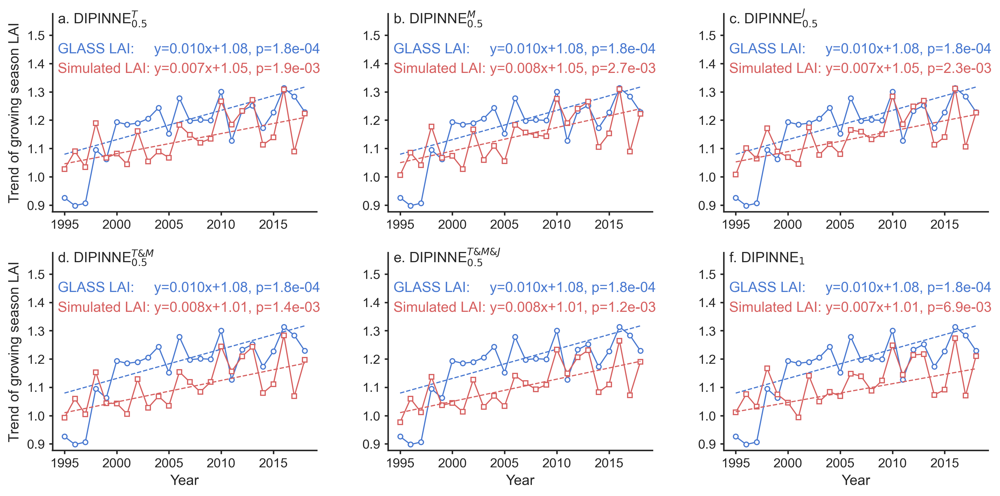

In [16]:
# plot the trend of LAI
model_plt = ['DIPINNE_0.5^T', 'DIPINNE_0.5^M', 'DIPINNE_0.5^J', 'DIPINNE_0.5^T&M', 'DIPINNE_0.5^T&M&J', 'DIPINNE_1']
fig = plt.figure(figsize=(12.2, 6), dpi=300)
for i, model in enumerate(model_plt):
    # get observed LAI and simulated LAI
    tst_period = pd.date_range('1995-1-1', '2018-12-31')
    df_obs = pd.read_csv('../data/LAI.csv', index_col=0, header=0, parse_dates=True)
    df_obs = df_obs[df_obs.index.isin(tst_period)]
    # resample simulated LAI to match the observed LAI
    sim_LAI = simulation[model]['mean']['LAI']
    sim_LAI.rename(columns={i: f'basin_{i}' for i in range(0, 69)}, inplace=True)
    df_sim = pd.DataFrame(index=df_obs.index, columns=df_obs.columns, dtype='float')
    for j in range(len(df_obs.index)):
        if j == len(df_obs.index) - 1:
            start_date = df_obs.index[j]
            df_sim.loc[start_date] = sim_LAI.loc[start_date:, :].mean(axis=0)
        else:
            start_date = df_obs.index[j]
            end_date = df_obs.index[j + 1]
            df_sim.loc[start_date] = sim_LAI.loc[start_date:end_date, :].mean(axis=0)

    # calculate annual maximum LAI for the sryr
    lai_sryr_obs = np.sum(df_obs.loc[:, basin] * basins.loc[i, 'Area'] for i, basin in enumerate(df_obs.columns)) / basins.loc[:, 'Area'].sum()
    lai_sryr_sim = np.sum(df_sim.loc[:, basin] * basins.loc[i, 'Area'] for i, basin in enumerate(df_sim.columns)) / basins.loc[:, 'Area'].sum()
    gs_during = [5, 9]
    lai_sryr_obs = lai_sryr_obs[(lai_sryr_obs.index.month >= gs_during[0]) & (lai_sryr_obs.index.month <= gs_during[-1])]
    lai_sryr_sim = lai_sryr_sim[(lai_sryr_sim.index.month >= gs_during[0]) & (lai_sryr_sim.index.month <= gs_during[-1])]
    lai_max_obs = lai_sryr_obs.groupby(lai_sryr_obs.index.year).mean()
    lai_max_sim = lai_sryr_sim.groupby(lai_sryr_sim.index.year).mean()

    ax = fig.add_subplot(2, 3, i+1)
    colors = sns.color_palette('muted', n_colors=4)
    # observed trend
    trend, h, p, z, Tau, s, var_s, slope, intercept = mk.original_test(lai_max_obs.values)
    trend_line = [slope * x + intercept for x in range(0, 24)]
    text_obs = f'GLASS LAI:     y={slope:.3f}x+{intercept:.2f}, p={p:.1e}' if intercept >= 0 else f'GLASS LAI:     y={slope:.3f}x-{intercept:.2f}, p={p:.1e}'
    ax.plot(lai_max_obs, color=colors[0], marker='o', linewidth=1, markerfacecolor='w', markersize=4, label='GLASS LAI')
    ax.plot(range(1995, 2019), trend_line, color=colors[0], linestyle='--', linewidth=1)
    ax.annotate(text_obs, xy=(0.02, 0.8), xycoords='axes fraction', color=colors[0], fontsize=12)

    # simulated trend
    trend, h, p, z, Tau, s, var_s, slope, intercept = mk.original_test(lai_max_sim.values)
    trend_line = [slope * x + intercept for x in range(0, 24)]
    text_sim = f'Simulated LAI: y={slope:.3f}x+{intercept:.2f}, p={p:.1e}' if intercept >= 0 else f'Simulated LAI: y={slope:.3f}x-{intercept:.2f}, p={p:.1e}'
    ax.plot(lai_max_sim, color=colors[3], marker='s', linewidth=1, markerfacecolor='w', markersize=4, label='Simulated LAI')
    ax.plot(range(1995, 2019), trend_line, color=colors[3], linestyle='--', linewidth=1)
    ax.annotate(text_sim, xy=(0.02, 0.7), xycoords='axes fraction', color=colors[3], fontsize=12)

    if i >= 3:
        ax.set_xlabel('Year')
    if i % 3 == 0:
        ax.set_ylabel('Trend of growing season LAI')
    ax.set_ylim(top=lai_max_obs.max()*1.2)
    ax.annotate(f'{chr(97+i)}. {legend_dict[model]}', xy=(0.02, 0.95), xycoords='axes fraction')
    # ax.xaxis.set_major_locator(plt.MaxNLocator(integer=True))
    ax.tick_params(axis='both', length=3)  # adjust tick length
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

# lines, labels = ax.get_legend_handles_labels()
# fig.legend(lines, labels, ncol=2, borderaxespad=0.1,
#            bbox_to_anchor=(0.35, 0.02, 0.35, 0.02), mode='expand', columnspacing=1, frameon=False, handletextpad=0.4)
fig.tight_layout(rect=(0, 0.0, 1, 1))

## Plot for ET metrics

### Plot violin plots

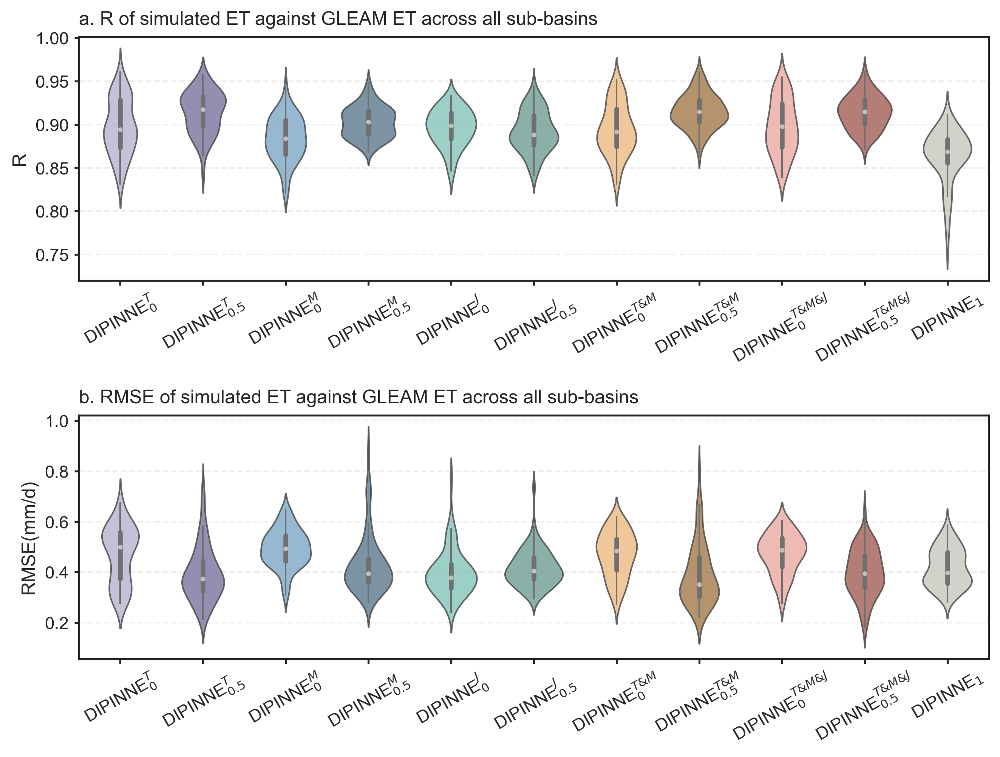

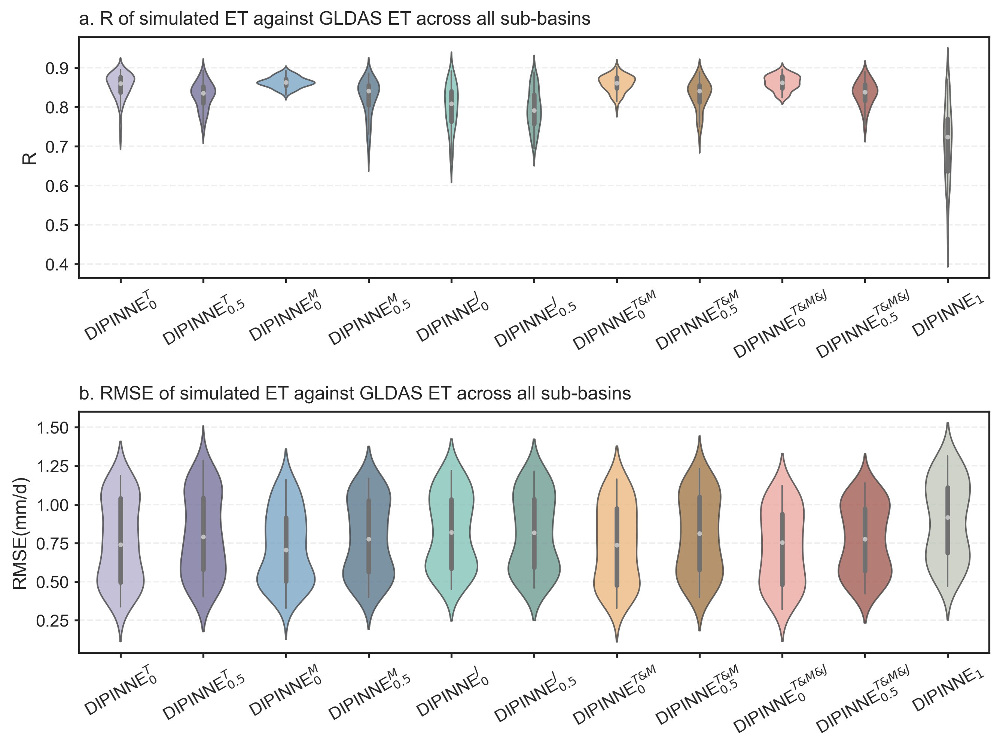

In [17]:
for rs in ['gleam', 'gldas']:
    fig = plt.figure(figsize=(9, 7), dpi=300)
    metricUnit = dict(zip(['R', 'RMSE'], ['', '(mm/d)']))
    model_plt = list(color_dict.keys())
    model_plt = [model_plt[num] for num in [0, 5, 1, 6, 2, 7, 3, 8, 4, 9, 10]]
    palette = sns.color_palette([color_dict[model] for model in model_plt])
    for i, metricName in enumerate(metricUnit.keys()):
        for k, var in enumerate(['ET']):
            axNum = i + 2 * k + 1
            ax = fig.add_subplot(2, 1, axNum)
            yTemp = [modelMetric[model][f'{var}_{rs}']['mean'][metricName] for model in model_plt]
            yTemp = [y[~np.isnan(y.astype('float'))] for y in yTemp]
            violins = sns.violinplot(yTemp, palette=palette, width=0.7, linewidth=1, inner='box', linecolor='lightgrey', fill=False, saturation=1, ax=ax)
            # change transparency of violins
            for violin in ax.collections[::2]:
                violin.set_alpha(0.8)
            for num in range(len(model_plt)):  # change the color of inner box
                c = '#707070'
                ax.get_children()[4*num+1].set_color(c)
                ax.get_children()[4*num+2].set_color(c)
                ax.get_children()[4*num+3].set_edgecolor('silver')
                ax.get_children()[4*num+3].set_facecolor('silver')

            xticklabels = [legend_dict[model] for model in model_plt]
            ax.set_xticklabels(xticklabels, rotation=30)
            ax.set_ylabel(metricName.upper() + metricUnit[metricName])

            if i == 0:
                ax.annotate(f'{chr(97+i+2*k)}. R of simulated {var} against {rs.upper()} ET across all sub-basins', xy=(0.0, 1.05), xycoords='axes fraction')
            else:
                ax.annotate(f'{chr(97+i+2*k)}. RMSE of simulated {var} against {rs.upper()} ET across all sub-basins', xy=(0.0, 1.05), xycoords='axes fraction')

            ax.grid(axis='y',ls='--',alpha=0.3)
            ax.tick_params(axis='both', length=3)  # adjust tick length

    fig.tight_layout(rect=(0, 0.01, 1, 0.99))

### Plot spatial distribution of ET

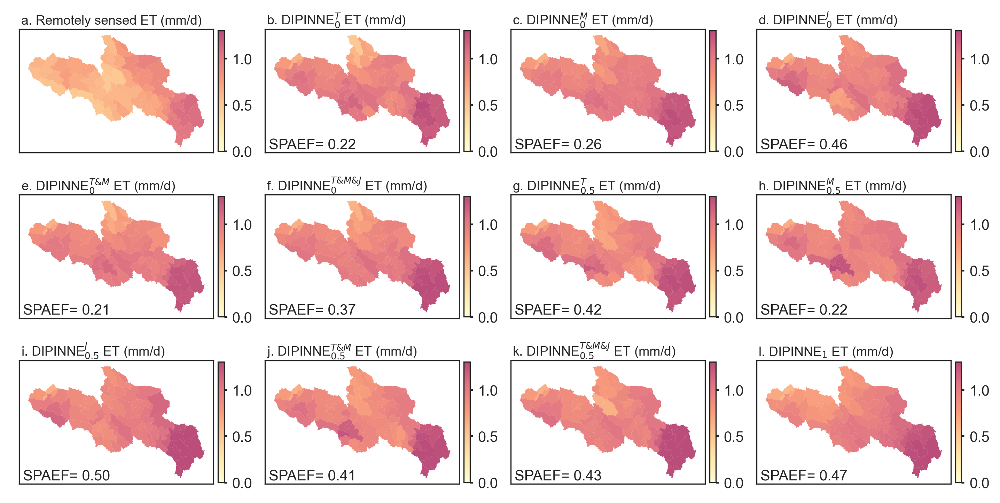

In [21]:
def plotEtMap(valData, simulation, cmaps, basinFile, figSize=(12, 6), ET_type='GLDAS', savePath=None):
    models = list(color_dict.keys())
    plt.rcParams['font.family'] = 'Arial'
    sns.set(style='ticks')
    basins = gpd.read_file(basinFile)
    metricUnit = dict(zip(['ET', 'Snow depth'], ['(mm/d)', '(mm)']))
    fig, axes = plt.subplots(nrows=3, ncols=4, figsize=figSize, dpi=300)
    for i, var in enumerate(['ET']):
        # calculate data to plot
        if var == 'ET':
            df = pd.DataFrame(columns=['Observed'] + models, index=range(0, 69))
            df.loc[:, 'Observed'] = valData[models[0]][f'{ET_type}Et'].groupby(valData[models[0]][f'{ET_type}Et'].index.year).mean().mean(axis=0).values
            for model in models:
                df.loc[:, model] = simulation[model]['mean']['E'].groupby(simulation[model]['mean']['E'].index.year).mean().mean(axis=0)
        else:
            df = pd.DataFrame(columns=['Observed'] + models, index=range(0, 69))
            df.loc[:, 'Observed'] = valData[models[0]]['snowDepth'].groupby(valData[models[0]]['snowDepth'].index.year).mean().mean(axis=0).values
            for model in models:
                df.loc[:, model] = simulation[model]['mean']['Sw'].groupby(simulation[model]['mean']['Sw'].index.year).mean().mean(axis=0)
        for j, item in enumerate(['Observed'] + models):
            # cmap = sns.color_palette(cmaps[i], as_cmap=True)
            cmap = yeRed
            ax = axes[j//4, j%4]
            dfPlot = pd.concat([basins, df], axis=1)
            # vmin, vmax = df.loc[:, item].values.min(), df.loc[:, item].values.max()
            vmin, vmax = 0, 1.3
            dfPlot.plot(column=item, ax=ax, cmap=cmap, edgecolor='None', linewidth=0.1, vmin=vmin, vmax=vmax, alpha=0.7)
            ax.set_xticks([])
            ax.set_yticks([])

            # Set axis spines properties
            lw = 0.8
            ax.spines['top'].set_linewidth(lw)  # Top spine thickness
            ax.spines['bottom'].set_linewidth(lw)  # Bottom spine thickness
            ax.spines['left'].set_linewidth(lw)  # Left spine thickness
            ax.spines['right'].set_linewidth(lw)  # Right spine thickness

            txtDict = {'ET': 'ET', 'Snow depth': 'snow water equivalent'}
            if item in models:
                text = f'{legend_dict[item]} {txtDict[var]} {metricUnit[var]}'
            else:
                text = 'Remotely sensed ET (mm/d)' if var == 'ET' else 'Remotely sensed snow depth (mm)'

            ax.annotate(f'{chr(97+i*4+j)}. {text}', xy=(0.01, 1.04), xycoords='axes fraction', fontsize=9)
            # calculate spatial similarity
            if item in models:
                obs, sim = df.loc[:, 'Observed'].values , df.loc[:, item].values
                alpha = np.corrcoef(obs, sim)[0, 1]
                beta = variation(sim) / variation(obs)
                bins = int(np.around(math.sqrt(len(obs)), 0))
                hobs, _ = np.histogram(zscore(obs),bins)
                hsim, _ = np.histogram(zscore(sim),bins)
                gamma = np.minimum(hobs, hsim).sum() / hobs.sum()
                spaEF = 1 - np.sqrt((alpha - 1) ** 2 + (beta - 1) ** 2 + (gamma - 1) ** 2)

                ax.annotate(f'SPAEF={spaEF: .2f}', xy=(0.02, 0.03), xycoords='axes fraction', fontsize=10)
            norm = cm.Normalize(vmin=vmin, vmax=vmax)
            sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
            cbar = plt.colorbar(sm, ax=ax, orientation='vertical', shrink=0.8, pad=0.02, alpha=0.7)
            cbar.ax.tick_params(direction='out', length=2, labelsize=10)
            cbar.outline.set_linewidth(lw)

    plt.subplots_adjust(wspace=0.05, hspace=0.1)
    # plt.tight_layout()
    if savePath is not None:
        plt.savefig(savePath)
    plt.show()

plotEtMap(valData=valData, simulation=simulation, cmaps=['light:#DE5C56', 'light:b'], basinFile='../data/sub-basins/watershed.shp', ET_type='GLEAM')

## Plot soil water dynamics.

In [ ]:
from typing import Union, List
import geopandas as gpd
from matplotlib import colors as cm

def plotSoilMap(sim, model, cmap, basinFile, tRange: Union[None, List[str]] = None, figSize=(10, 2.5), savePath=None, fmt='pdf'):
    import warnings
    warnings.filterwarnings('ignore')  # ignore the warning of plt.tight_layout()
    plt.rcParams['font.family'] = 'Arial'
    sns.set(style='ticks')
    if tRange is None:
        tRange = ['2000-1-1', '2019-12-31']
    tRange = pd.date_range(tRange[0], tRange[1])
    basins = gpd.read_file(basinFile)

    # calculate monthly mean soil water
    dfTempSolid = sim[model]['mean']['Sss'][sim[model]['mean']['Sss'].index.isin(tRange)]
    dfTempLiquid =  sim[model]['mean']['Ssl'][sim[model]['mean']['Ssl'].index.isin(tRange)]
    dfMeanSolid = dfTempSolid.groupby(dfTempSolid.index.month).mean().T
    dfMeanLiquid = dfTempLiquid.groupby(dfTempLiquid.index.month).mean().T
    dfMean = {'Sss': dfMeanSolid, 'Ssl': dfMeanLiquid}

    # get a month dict for annotation
    monDict = {1: 'Jan', 2: 'Feb', 3: 'Mar', 4: 'Apr', 5: 'May', 6: 'Jun', 7: 'Jul', 8: 'Aug', 9: 'Sep',
               10: 'Oct', 11: 'Nov', 12: 'Dec'}

    # set color bar annotation
    labelDict = {'Sss': 'Frozen water (mm)', 'Ssl': 'Unfrozen water (mm)'}
    vMin, vMax = 9999, -9999
    for var in ['Ssl', 'Sss']:
        dfPlot = pd.concat([basins, dfMean[var]], axis=1)
        fig, axes = plt.subplots(nrows=2, ncols=6, figsize=figSize, dpi=300)
        cbarAx = fig.add_axes([0.907, 0.168, 0.007, 0.658])  # left, bottom, width, height
        # Normalize the colormap to the data range
        vMin = dfPlot[range(1, 13)].min().min() if dfPlot[range(1, 13)].min().min() < vMin else vMin
        vMax = dfPlot[range(1, 13)].max().max() if dfPlot[range(1, 13)].max().max() > vMax else vMax
        for month in range(1, 13):
            axRow, axCol = int((month - 1) / 6), (month - 1) % 6
            ax = axes[axRow, axCol]
            dfPlot.plot(column=month, ax=ax, cmap=cmap, edgecolor='None', linewidth=0.1)
            ax.annotate(monDict[month], xy=(0.03, 0.05), xycoords='axes fraction', fontsize=10)
            ax.set_xticks([])
            ax.set_yticks([])

            # Set axis spines properties
            lw = 0.8
            ax.spines['top'].set_linewidth(lw)  # Top spine thickness
            ax.spines['bottom'].set_linewidth(lw)  # Bottom spine thickness
            ax.spines['left'].set_linewidth(lw)  # Left spine thickness
            ax.spines['right'].set_linewidth(lw)  # Right spine thickness

            # # Set axis spines colors with transparency
            # color = (0, 0, 0, 0.7)
            # ax.spines['top'].set_color(color)
            # ax.spines['bottom'].set_color(color)
            # ax.spines['left'].set_color(color)
            # ax.spines['right'].set_color(color)

        # add a color bar for all axes
        norm = cm.Normalize(vmin=vMin, vmax=vMax)
        sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
        cbar = plt.colorbar(sm, cax=cbarAx, orientation='vertical')

        cbar.ax.set_ylabel(labelDict[var], fontsize=10)
        cbar.ax.tick_params(direction='out', length=2, labelsize=10)
        cbar.outline.set_linewidth(lw)

        # plt.tight_layout(rect=[0, 0, 0.95, 1])  # left, bottom, right, top
        plt.subplots_adjust(wspace=0.1, hspace=-0.15)
        if savePath is not None:
            plt.savefig(os.path.join(savePath, f'{var}.{fmt}'))
        plt.show()

In [ ]:
cMap = sns.color_palette('light:b', as_cmap=True)
plotSoilMap(simulation, model='DIPINNE_0^T&M&J', cmap=cMap, basinFile='../data/sub-basins/watershed.shp', figSize=(10, 2.5), savePath=rootDir)

In [ ]:
plotSoilMap(simulation, model='DIPINNE_0.5^T&M&J', cmap=cMap, basinFile='../data/sub-basins/watershed.shp', figSize=(10, 2.5), savePath=rootDir)

In [ ]:
plotSoilMap(simulation, model='DIPINNE_1', cmap=cMap, basinFile='../data/sub-basins/watershed.shp', figSize=(10, 2.5), savePath=rootDir)

## Plot parameters for comparison

In [ ]:
para_dict = {'static': ['parTMIN', 'parDDF', 'parTMAX', 'parQMAX', 'parSMAX', 'parIMAX', 'parKS'],
             'dynamic': ['parF', 'parALPHA', 'parRSUB', 'parKsg', 'parWUE']}
para_unit = {'parTMIN': '$^\circ$C', 'parDDF': 'mm/$^\circ$C/d', 'parTMAX': '$^\circ$C', 'parQMAX': 'mm/d', 'parSMAX': 'mm', 'parIMAX': 'mm',
             'parKS': '-', 'parF': '-', 'parALPHA': '-', 'parRSUB': '-', 'parKsg': 'd$^-1$', 'parWUE': 'kg CO2/kg H2O'}

In [ ]:
# plot static parameters
basins = gpd.read_file('../data/sub-basins/watershed.shp')
cmap = 'coolwarm'
for model in list(color_dict.keys()):
    fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(12, 4), dpi=300)
    for i, para_name in enumerate(para_dict['static']):
        ax = axes[i//4, i%4]
        para_value = simulation[model]['mean']['static'][:, i]
        basins.loc[:, para_name] = para_value
        basins.plot(column=para_name, ax=ax, cmap=cmap, edgecolor='None', linewidth=0.1, vmin=para_value.min(), vmax=para_value.max(), alpha=0.8)
        ax.set_xticks([])
        ax.set_yticks([])

        # Set axis spines properties
        lw = 0.8
        ax.spines['top'].set_linewidth(lw)  # Top spine thickness
        ax.spines['bottom'].set_linewidth(lw)  # Bottom spine thickness
        ax.spines['left'].set_linewidth(lw)  # Left spine thickness
        ax.spines['right'].set_linewidth(lw)  # Right spine thickness

        ax.annotate(f'{chr(97+i)}. {para_name} ({para_unit[para_name]})', xy=(0.01, 1.04), xycoords='axes fraction', fontsize=10)
        norm = cm.Normalize(vmin=para_value.min(), vmax=para_value.max())
        sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
        cbar = plt.colorbar(sm, ax=ax, orientation='vertical', shrink=0.76, pad=0.02, alpha=0.7)
        cbar.ax.tick_params(direction='out', length=2, labelsize=10)
        cbar.outline.set_linewidth(lw)

    plt.delaxes(ax=axes[1, 3])
    plt.tight_layout()